# **Authentication**

In [0]:
storage_account_name = "projectab2ib"
container_name = "raw"
account_key = "******"

spark.conf.set(
    f"fs.azure.account.key.{storage_account_name}.dfs.core.windows.net",
    account_key
)


base_path = f"abfss://{container_name}@{storage_account_name}.dfs.core.windows.net"
print("Base path:", base_path)


Base path: abfss://raw@projectab2ib.dfs.core.windows.net


#**Loading Datasets and Intial Explioration**

In [0]:
# Listing the files of the dataset:

files = dbutils.fs.ls(base_path)
csv_files = [f for f in files if f.path.lower().endswith(".csv")]
for f in csv_files:
    size_mb = f.size / (1024 * 1024)
    print(f"{f.name:60s} | {size_mb:8.2f} MB")

Friday-02-03-2018_TrafficForML_CICFlowMeter.csv              |   336.04 MB
Friday-16-02-2018_TrafficForML_CICFlowMeter.csv              |   318.26 MB
Friday-23-02-2018_TrafficForML_CICFlowMeter.csv              |   365.11 MB
Thuesday-20-02-2018_TrafficForML_CICFlowMeter.csv            |  3867.08 MB
Thursday-01-03-2018_TrafficForML_CICFlowMeter.csv            |   102.85 MB
Thursday-15-02-2018_TrafficForML_CICFlowMeter.csv            |   358.53 MB
Thursday-22-02-2018_TrafficForML_CICFlowMeter.csv            |   364.91 MB
Wednesday-14-02-2018_TrafficForML_CICFlowMeter.csv           |   341.63 MB
Wednesday-21-02-2018_TrafficForML_CICFlowMeter.csv           |   313.66 MB
Wednesday-28-02-2018_TrafficForML_CICFlowMeter.csv           |   199.56 MB


In [0]:
# Information about the dataset:

from pyspark.sql import DataFrame

summary_rows = []
for f in csv_files:
    print(f"Reading {f.name} ...")
    df: DataFrame = (
        spark.read
        .option("header", "true")
        .option("inferSchema", "true")
        .csv(f.path)
    )
    row_count = df.count()
    col_count = len(df.columns)
    size_mb   = f.size / (1024 * 1024)
    summary_rows.append((
        f.name,
        f.path,
        float(size_mb),
        int(row_count),
        int(col_count)
    ))
summary_df = spark.createDataFrame(
    summary_rows,
    ["file_name", "path", "size_mb", "row_count", "col_count"]
)
display(summary_df.orderBy("file_name"))

Reading Friday-02-03-2018_TrafficForML_CICFlowMeter.csv ...
Reading Friday-16-02-2018_TrafficForML_CICFlowMeter.csv ...
Reading Friday-23-02-2018_TrafficForML_CICFlowMeter.csv ...
Reading Thuesday-20-02-2018_TrafficForML_CICFlowMeter.csv ...
Reading Thursday-01-03-2018_TrafficForML_CICFlowMeter.csv ...
Reading Thursday-15-02-2018_TrafficForML_CICFlowMeter.csv ...
Reading Thursday-22-02-2018_TrafficForML_CICFlowMeter.csv ...
Reading Wednesday-14-02-2018_TrafficForML_CICFlowMeter.csv ...
Reading Wednesday-21-02-2018_TrafficForML_CICFlowMeter.csv ...
Reading Wednesday-28-02-2018_TrafficForML_CICFlowMeter.csv ...


file_name,path,size_mb,row_count,col_count
Friday-02-03-2018_TrafficForML_CICFlowMeter.csv,abfss://raw@projectab2ib.dfs.core.windows.net/Friday-02-03-2018_TrafficForML_CICFlowMeter.csv,336.0446672439575,1048575,80
Friday-16-02-2018_TrafficForML_CICFlowMeter.csv,abfss://raw@projectab2ib.dfs.core.windows.net/Friday-16-02-2018_TrafficForML_CICFlowMeter.csv,318.2636308670044,1048575,80
Friday-23-02-2018_TrafficForML_CICFlowMeter.csv,abfss://raw@projectab2ib.dfs.core.windows.net/Friday-23-02-2018_TrafficForML_CICFlowMeter.csv,365.10511016845703,1048575,80
Thuesday-20-02-2018_TrafficForML_CICFlowMeter.csv,abfss://raw@projectab2ib.dfs.core.windows.net/Thuesday-20-02-2018_TrafficForML_CICFlowMeter.csv,3867.078161239624,7948748,84
Thursday-01-03-2018_TrafficForML_CICFlowMeter.csv,abfss://raw@projectab2ib.dfs.core.windows.net/Thursday-01-03-2018_TrafficForML_CICFlowMeter.csv,102.84696388244629,331125,80
Thursday-15-02-2018_TrafficForML_CICFlowMeter.csv,abfss://raw@projectab2ib.dfs.core.windows.net/Thursday-15-02-2018_TrafficForML_CICFlowMeter.csv,358.5299482345581,1048575,80
Thursday-22-02-2018_TrafficForML_CICFlowMeter.csv,abfss://raw@projectab2ib.dfs.core.windows.net/Thursday-22-02-2018_TrafficForML_CICFlowMeter.csv,364.9103183746338,1048575,80
Wednesday-14-02-2018_TrafficForML_CICFlowMeter.csv,abfss://raw@projectab2ib.dfs.core.windows.net/Wednesday-14-02-2018_TrafficForML_CICFlowMeter.csv,341.62839221954346,1048575,80
Wednesday-21-02-2018_TrafficForML_CICFlowMeter.csv,abfss://raw@projectab2ib.dfs.core.windows.net/Wednesday-21-02-2018_TrafficForML_CICFlowMeter.csv,313.6574487686157,1048575,80
Wednesday-28-02-2018_TrafficForML_CICFlowMeter.csv,abfss://raw@projectab2ib.dfs.core.windows.net/Wednesday-28-02-2018_TrafficForML_CICFlowMeter.csv,199.55611991882324,613104,80


In [0]:
from pyspark.sql import DataFrame

schemas = []

for f in csv_files:
    df = (
        spark.read
        .option("header", "true")
        .option("inferSchema", "true")
        .csv(f.path)
    )
    schemas.append((f.name, set(df.columns)))

# union of all columns & intersection (common to all files)
all_cols = set().union(*[s[1] for s in schemas])
common_cols = set.intersection(*[s[1] for s in schemas])

print("Total distinct columns across all files:", len(all_cols))
print("Columns present in ALL files:", len(common_cols))

print("\nExtra columns (present only in some files):")
for name, cols in schemas:
    extras = cols - common_cols
    if extras:
        print(f"- {name}: {sorted(list(extras))}")


Total distinct columns across all files: 84
Columns present in ALL files: 80

Extra columns (present only in some files):
- Thuesday-20-02-2018_TrafficForML_CICFlowMeter.csv: ['Dst IP', 'Flow ID', 'Src IP', 'Src Port']


In [0]:
from pyspark.sql import DataFrame

# Turn the set of common columns into a sorted list for stable ordering
common_cols_list = sorted(list(common_cols))
print("Using", len(common_cols_list), "common columns")

dfs = []

for f in csv_files:
    print(f"Loading {f.name} with common columns only ...")
    
    df = (
        spark.read
        .option("header", "true")
        .option("inferSchema", "true")
        .csv(f.path)
        .select(common_cols_list)          # keep only columns shared by all files
    )
    
    dfs.append(df)

# Combine all DataFrames
from functools import reduce

combined_df: DataFrame = reduce(
    lambda a, b: a.unionByName(b),
    dfs
)

combined_df.cache()
print("Total rows across all files:", combined_df.count())
print("Number of columns:", len(combined_df.columns))
combined_df.printSchema()
display(combined_df.limit(5))


Using 80 common columns
Loading Friday-02-03-2018_TrafficForML_CICFlowMeter.csv with common columns only ...
Loading Friday-16-02-2018_TrafficForML_CICFlowMeter.csv with common columns only ...
Loading Friday-23-02-2018_TrafficForML_CICFlowMeter.csv with common columns only ...
Loading Thuesday-20-02-2018_TrafficForML_CICFlowMeter.csv with common columns only ...
Loading Thursday-01-03-2018_TrafficForML_CICFlowMeter.csv with common columns only ...
Loading Thursday-15-02-2018_TrafficForML_CICFlowMeter.csv with common columns only ...
Loading Thursday-22-02-2018_TrafficForML_CICFlowMeter.csv with common columns only ...
Loading Wednesday-14-02-2018_TrafficForML_CICFlowMeter.csv with common columns only ...
Loading Wednesday-21-02-2018_TrafficForML_CICFlowMeter.csv with common columns only ...
Loading Wednesday-28-02-2018_TrafficForML_CICFlowMeter.csv with common columns only ...
Total rows across all files: 16233002
Number of columns: 80
root
 |-- ACK Flag Cnt: integer (nullable = true)

ACK Flag Cnt,Active Max,Active Mean,Active Min,Active Std,Bwd Blk Rate Avg,Bwd Byts/b Avg,Bwd Header Len,Bwd IAT Max,Bwd IAT Mean,Bwd IAT Min,Bwd IAT Std,Bwd IAT Tot,Bwd PSH Flags,Bwd Pkt Len Max,Bwd Pkt Len Mean,Bwd Pkt Len Min,Bwd Pkt Len Std,Bwd Pkts/b Avg,Bwd Pkts/s,Bwd Seg Size Avg,Bwd URG Flags,CWE Flag Count,Down/Up Ratio,Dst Port,ECE Flag Cnt,FIN Flag Cnt,Flow Byts/s,Flow Duration,Flow IAT Max,Flow IAT Mean,Flow IAT Min,Flow IAT Std,Flow Pkts/s,Fwd Act Data Pkts,Fwd Blk Rate Avg,Fwd Byts/b Avg,Fwd Header Len,Fwd IAT Max,Fwd IAT Mean,Fwd IAT Min,Fwd IAT Std,Fwd IAT Tot,Fwd PSH Flags,Fwd Pkt Len Max,Fwd Pkt Len Mean,Fwd Pkt Len Min,Fwd Pkt Len Std,Fwd Pkts/b Avg,Fwd Pkts/s,Fwd Seg Size Avg,Fwd Seg Size Min,Fwd URG Flags,Idle Max,Idle Mean,Idle Min,Idle Std,Init Bwd Win Byts,Init Fwd Win Byts,Label,PSH Flag Cnt,Pkt Len Max,Pkt Len Mean,Pkt Len Min,Pkt Len Std,Pkt Len Var,Pkt Size Avg,Protocol,RST Flag Cnt,SYN Flag Cnt,Subflow Bwd Byts,Subflow Bwd Pkts,Subflow Fwd Byts,Subflow Fwd Pkts,Timestamp,Tot Bwd Pkts,Tot Fwd Pkts,TotLen Bwd Pkts,TotLen Fwd Pkts,URG Flag Cnt
0,0.0,0.0,0.0,0.0,0,0,152,31525.0,8569.5,1.0,13036.89082,51417.0,0,1460.0,539.0,0.0,655.4329358,0,49.51020264,539.0,0,0,0.0,443,1,0,30597.30523,141385,73403.0,9425.666667,1.0,19069.11685,113.1661775,4,0,0,192,73403.0,17673.125,22.0,23965.32327,141385.0,0,202.0,61.44444444,0.0,87.53443767,0,63.65597482,61.44444444,20,0,0.0,0.0,0.0,0.0,119,8192,Benign,1,1460.0,254.4705882,0.0,474.7129551,225352.3897,270.375,6,1,0,3773,7,553,9,02/03/2018 08:47:38,7,9,3773.0,553.0,0
1,0.0,0.0,0.0,0.0,0,0,20,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,3558.718861,0.0,0,0,0.0,49684,0,0,135231.3167,281,264.0,140.5,17.0,174.655375,10676.15658,0,0,0,40,281.0,281.0,281.0,0.0,281.0,1,38.0,19.0,0.0,26.87005769,0,7117.437722,19.0,20,0,0.0,0.0,0.0,0.0,0,123,Benign,0,38.0,19.0,0.0,21.93931023,481.3333333,25.33333333,6,0,1,0,1,38,2,02/03/2018 08:47:38,1,2,0.0,38.0,0
0,0.0,0.0,0.0,0.0,0,0,312,133669.0,18494.57143,1.0,36356.50372,258924.0,0,1460.0,701.8,0.0,636.3141856,0,53.60512322,701.8,0,0,1.0,443,1,0,41501.0864,279824,112589.0,11192.96,1.0,24379.44834,92.91554692,5,0,0,232,112589.0,27972.8,94.0,36167.74032,279728.0,0,385.0,98.72727273,0.0,129.3924966,0,39.31042369,98.72727273,20,0,0.0,0.0,0.0,0.0,1047,8192,Benign,1,1460.0,430.1111111,0.0,566.234209,320621.1795,446.6538462,6,1,0,10527,15,1086,11,02/03/2018 08:47:40,15,11,10527.0,1086.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,443,0,0,0.0,132,132.0,132.0,132.0,0.0,15151.51515,0,0,0,40,132.0,132.0,132.0,0.0,132.0,0,0.0,0.0,0.0,0.0,0,15151.51515,0.0,20,0,0.0,0.0,0.0,0.0,-1,256,Benign,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,02/03/2018 08:47:40,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,272,135611.0,21082.83333,1.0,39075.73819,252994.0,0,1460.0,472.3846154,0.0,611.1804887,0,47.44248511,472.3846154,0,0,1.0,443,1,0,27100.60726,274016,114077.0,13048.38095,1.0,26311.62703,80.28728249,5,0,0,192,114077.0,34243.25,201.0,37996.56546,273946.0,0,517.0,142.7777778,0.0,183.8877224,0,32.84479738,142.7777778,20,0,0.0,0.0,0.0,0.0,1047,8192,Benign,1,1460.0,322.8695652,0.0,497.2547641,247262.3004,337.5454545,6,1,0,6141,13,1285,9,02/03/2018 08:47:41,13,9,6141.0,1285.0,0


In [0]:
display(combined_df.limit(20))


ACK Flag Cnt,Active Max,Active Mean,Active Min,Active Std,Bwd Blk Rate Avg,Bwd Byts/b Avg,Bwd Header Len,Bwd IAT Max,Bwd IAT Mean,Bwd IAT Min,Bwd IAT Std,Bwd IAT Tot,Bwd PSH Flags,Bwd Pkt Len Max,Bwd Pkt Len Mean,Bwd Pkt Len Min,Bwd Pkt Len Std,Bwd Pkts/b Avg,Bwd Pkts/s,Bwd Seg Size Avg,Bwd URG Flags,CWE Flag Count,Down/Up Ratio,Dst Port,ECE Flag Cnt,FIN Flag Cnt,Flow Byts/s,Flow Duration,Flow IAT Max,Flow IAT Mean,Flow IAT Min,Flow IAT Std,Flow Pkts/s,Fwd Act Data Pkts,Fwd Blk Rate Avg,Fwd Byts/b Avg,Fwd Header Len,Fwd IAT Max,Fwd IAT Mean,Fwd IAT Min,Fwd IAT Std,Fwd IAT Tot,Fwd PSH Flags,Fwd Pkt Len Max,Fwd Pkt Len Mean,Fwd Pkt Len Min,Fwd Pkt Len Std,Fwd Pkts/b Avg,Fwd Pkts/s,Fwd Seg Size Avg,Fwd Seg Size Min,Fwd URG Flags,Idle Max,Idle Mean,Idle Min,Idle Std,Init Bwd Win Byts,Init Fwd Win Byts,Label,PSH Flag Cnt,Pkt Len Max,Pkt Len Mean,Pkt Len Min,Pkt Len Std,Pkt Len Var,Pkt Size Avg,Protocol,RST Flag Cnt,SYN Flag Cnt,Subflow Bwd Byts,Subflow Bwd Pkts,Subflow Fwd Byts,Subflow Fwd Pkts,Timestamp,Tot Bwd Pkts,Tot Fwd Pkts,TotLen Bwd Pkts,TotLen Fwd Pkts,URG Flag Cnt
0,0.0,0.0,0.0,0.0,0,0,152,31525.0,8569.5,1.0,13036.89082,51417.0,0,1460.0,539.0,0.0,655.4329358,0,49.51020264,539.0,0,0,0.0,443,1,0,30597.30523,141385,73403.0,9425.666667,1.0,19069.11685,113.1661775,4,0,0,192,73403.0,17673.125,22.0,23965.32327,141385.0,0,202.0,61.44444444,0.0,87.53443767,0,63.65597482,61.44444444,20,0,0.0,0.0,0.0,0.0,119,8192,Benign,1,1460.0,254.4705882,0.0,474.7129551,225352.3897,270.375,6,1,0,3773,7,553,9,02/03/2018 08:47:38,7,9,3773.0,553.0,0
1,0.0,0.0,0.0,0.0,0,0,20,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,3558.718861,0.0,0,0,0.0,49684,0,0,135231.3167,281,264.0,140.5,17.0,174.655375,10676.15658,0,0,0,40,281.0,281.0,281.0,0.0,281.0,1,38.0,19.0,0.0,26.87005769,0,7117.437722,19.0,20,0,0.0,0.0,0.0,0.0,0,123,Benign,0,38.0,19.0,0.0,21.93931023,481.3333333,25.33333333,6,0,1,0,1,38,2,02/03/2018 08:47:38,1,2,0.0,38.0,0
0,0.0,0.0,0.0,0.0,0,0,312,133669.0,18494.57143,1.0,36356.50372,258924.0,0,1460.0,701.8,0.0,636.3141856,0,53.60512322,701.8,0,0,1.0,443,1,0,41501.0864,279824,112589.0,11192.96,1.0,24379.44834,92.91554692,5,0,0,232,112589.0,27972.8,94.0,36167.74032,279728.0,0,385.0,98.72727273,0.0,129.3924966,0,39.31042369,98.72727273,20,0,0.0,0.0,0.0,0.0,1047,8192,Benign,1,1460.0,430.1111111,0.0,566.234209,320621.1795,446.6538462,6,1,0,10527,15,1086,11,02/03/2018 08:47:40,15,11,10527.0,1086.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,443,0,0,0.0,132,132.0,132.0,132.0,0.0,15151.51515,0,0,0,40,132.0,132.0,132.0,0.0,132.0,0,0.0,0.0,0.0,0.0,0,15151.51515,0.0,20,0,0.0,0.0,0.0,0.0,-1,256,Benign,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,02/03/2018 08:47:40,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,272,135611.0,21082.83333,1.0,39075.73819,252994.0,0,1460.0,472.3846154,0.0,611.1804887,0,47.44248511,472.3846154,0,0,1.0,443,1,0,27100.60726,274016,114077.0,13048.38095,1.0,26311.62703,80.28728249,5,0,0,192,114077.0,34243.25,201.0,37996.56546,273946.0,0,517.0,142.7777778,0.0,183.8877224,0,32.84479738,142.7777778,20,0,0.0,0.0,0.0,0.0,1047,8192,Benign,1,1460.0,322.8695652,0.0,497.2547641,247262.3004,337.5454545,6,1,0,6141,13,1285,9,02/03/2018 08:47:41,13,9,6141.0,1285.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,443,0,0,0.0,250,250.0,250.0,250.0,0.0,8000.0,0,0,0,40,250.0,250.0,250.0,0.0,250.0,0,0.0,0.0,0.0,0.0,0,8000.0,0.0,20,0,0.0,0.0,0.0,0.0,-1,251,Benign,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,02/03/2018 08:47:41,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,32,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.167671775,0.0,0,0,0.0,80,1,0,0.0,5964033,5943084.0,1988011.0,19.0,3425209.65,0.6706871,0,0,0,72,5943084.0,2982016.5,20949.0,4187581.818,5964033.0,0,0.0,0.0,0.0,0.0,0,0.503015325,0.0,20,0,0.0,0.0,0.0,0.0,29200,8192,Benign,1,0.0,0.0,0.0,0.0,0.0,0.0,6,1,0,0,1,0,3,02/03/2018 08:47:41,1,3,0.0,0.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,49690,0,0,0.0,144,144.0,144.0,144.0,0

In [0]:
combined_df.printSchema()


root
 |-- ACK Flag Cnt: integer (nullable = true)
 |-- Active Max: double (nullable = true)
 |-- Active Mean: double (nullable = true)
 |-- Active Min: double (nullable = true)
 |-- Active Std: double (nullable = true)
 |-- Bwd Blk Rate Avg: integer (nullable = true)
 |-- Bwd Byts/b Avg: integer (nullable = true)
 |-- Bwd Header Len: integer (nullable = true)
 |-- Bwd IAT Max: double (nullable = true)
 |-- Bwd IAT Mean: double (nullable = true)
 |-- Bwd IAT Min: double (nullable = true)
 |-- Bwd IAT Std: double (nullable = true)
 |-- Bwd IAT Tot: double (nullable = true)
 |-- Bwd PSH Flags: integer (nullable = true)
 |-- Bwd Pkt Len Max: double (nullable = true)
 |-- Bwd Pkt Len Mean: double (nullable = true)
 |-- Bwd Pkt Len Min: double (nullable = true)
 |-- Bwd Pkt Len Std: double (nullable = true)
 |-- Bwd Pkts/b Avg: integer (nullable = true)
 |-- Bwd Pkts/s: double (nullable = true)
 |-- Bwd Seg Size Avg: double (nullable = true)
 |-- Bwd URG Flags: integer (nullable = true)
 |--

In [0]:
from pyspark.sql.functions import rand, col

print("=== Schema ===")
combined_df.printSchema()

print("\n=== Random Sample ===")
display(combined_df.orderBy(rand()).limit(20))

print("\n=== Label Distribution ===")
display(
    combined_df.groupBy(col("Label"))
               .count()
               .orderBy("count", ascending=False)
)


=== Schema ===
root
 |-- ACK Flag Cnt: integer (nullable = true)
 |-- Active Max: double (nullable = true)
 |-- Active Mean: double (nullable = true)
 |-- Active Min: double (nullable = true)
 |-- Active Std: double (nullable = true)
 |-- Bwd Blk Rate Avg: integer (nullable = true)
 |-- Bwd Byts/b Avg: integer (nullable = true)
 |-- Bwd Header Len: integer (nullable = true)
 |-- Bwd IAT Max: double (nullable = true)
 |-- Bwd IAT Mean: double (nullable = true)
 |-- Bwd IAT Min: double (nullable = true)
 |-- Bwd IAT Std: double (nullable = true)
 |-- Bwd IAT Tot: double (nullable = true)
 |-- Bwd PSH Flags: integer (nullable = true)
 |-- Bwd Pkt Len Max: double (nullable = true)
 |-- Bwd Pkt Len Mean: double (nullable = true)
 |-- Bwd Pkt Len Min: double (nullable = true)
 |-- Bwd Pkt Len Std: double (nullable = true)
 |-- Bwd Pkts/b Avg: integer (nullable = true)
 |-- Bwd Pkts/s: double (nullable = true)
 |-- Bwd Seg Size Avg: double (nullable = true)
 |-- Bwd URG Flags: integer (nullab

ACK Flag Cnt,Active Max,Active Mean,Active Min,Active Std,Bwd Blk Rate Avg,Bwd Byts/b Avg,Bwd Header Len,Bwd IAT Max,Bwd IAT Mean,Bwd IAT Min,Bwd IAT Std,Bwd IAT Tot,Bwd PSH Flags,Bwd Pkt Len Max,Bwd Pkt Len Mean,Bwd Pkt Len Min,Bwd Pkt Len Std,Bwd Pkts/b Avg,Bwd Pkts/s,Bwd Seg Size Avg,Bwd URG Flags,CWE Flag Count,Down/Up Ratio,Dst Port,ECE Flag Cnt,FIN Flag Cnt,Flow Byts/s,Flow Duration,Flow IAT Max,Flow IAT Mean,Flow IAT Min,Flow IAT Std,Flow Pkts/s,Fwd Act Data Pkts,Fwd Blk Rate Avg,Fwd Byts/b Avg,Fwd Header Len,Fwd IAT Max,Fwd IAT Mean,Fwd IAT Min,Fwd IAT Std,Fwd IAT Tot,Fwd PSH Flags,Fwd Pkt Len Max,Fwd Pkt Len Mean,Fwd Pkt Len Min,Fwd Pkt Len Std,Fwd Pkts/b Avg,Fwd Pkts/s,Fwd Seg Size Avg,Fwd Seg Size Min,Fwd URG Flags,Idle Max,Idle Mean,Idle Min,Idle Std,Init Bwd Win Byts,Init Fwd Win Byts,Label,PSH Flag Cnt,Pkt Len Max,Pkt Len Mean,Pkt Len Min,Pkt Len Std,Pkt Len Var,Pkt Size Avg,Protocol,RST Flag Cnt,SYN Flag Cnt,Subflow Bwd Byts,Subflow Bwd Pkts,Subflow Fwd Byts,Subflow Fwd Pkts,Timestamp,Tot Bwd Pkts,Tot Fwd Pkts,TotLen Bwd Pkts,TotLen Fwd Pkts,URG Flag Cnt
0,0.0,0.0,0.0,0.0,0,0,148,937496.0,330227.166666667,158878.0,302075.892191626,1981363.0,0,1173.0,225.8571428571,0.0,430.0986044197,0,3.0414841052,225.8571428571,0,0,0.0,3389,0,0,1185.7443033003,2301508,937496.0,164393.428571429,96.0,249631.018190915,6.5174659397,5,0,0,168,1321081.0,328786.857142857,156.0,446055.974151387,2301508.0,0,677.0,143.5,0.0,228.129662379,0,3.4759818345,143.5,20,0,0.0,0.0,0.0,0.0,62852,8192,Benign,1,1173.0,170.5625,0.0,319.433241591,102037.595833333,181.9333333333,6,0,0,1581,7,1148,8,22/02/2018 03:17:51,7,8,1581.0,1148.0,0
0,7077910.0,7077910.0,7077910.0,0.0,0,0,192,1.6E7,6199595.8,998155.0,6099541.807,3.1E7,0,0.0,0.0,0.0,0.0,0,0.193063816,0.0,0,0,6.0,443,1,0,0.0,31077807,1.6E7,5179634.5,79828.0,6000454.526,0.225241118,0,0,0,32,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.032177303,0.0,32,0,1.6E7,1.2E7,7999998.0,5656784.246,29200,8192,Benign,1,0.0,0.0,0.0,0.0,0.0,0.0,6,1,0,0,6,0,1,28/02/2018 03:34:13,6,1,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,92,8258.0,2874.666667,1.0,4665.654545,8624.0,0,112.0,32.25,0.0,53.7672453,0,441.3062665,32.25,0,0,1.0,8080,1,0,50198.58782,9064,8258.0,1510.666667,1.0,3310.057502,772.2859665,1,0,0,72,462.0,258.0,54.0,288.4995667,516.0,0,326.0,108.6666667,0.0,188.2161878,0,330.9796999,108.6666667,20,0,0.0,0.0,0.0,0.0,219,8192,Bot,1,326.0,56.875,0.0,115.4066568,13318.69643,65.0,6,1,0,129,4,326,3,02/03/2018 11:18:57,4,3,129.0,326.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,80,0,0,0.0,129,129.0,129.0,129.0,0.0,15503.8759689923,0,0,0,40,129.0,129.0,129.0,0.0,129.0,0,0.0,0.0,0.0,0.0,0,15503.8759689923,0.0,20,0,0.0,0.0,0.0,0.0,-1,255,Benign,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,22/02/2018 01:28:06,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,8,0.0,0.0,0.0,0.0,0.0,0,108.0,108.0,108.0,0.0,0,1828.1535648994518,108.0,0,0,1.0,53,0,0,259597.80621572214,547,547.0,547.0,547.0,0.0,3656.3071297989036,0,0,0,8,0.0,0.0,0.0,0.0,0.0,0,34.0,34.0,34.0,0.0,0,1828.1535648994518,34.0,8,0,0.0,0.0,0.0,0.0,-1,-1,Benign,0,108.0,58.66666666666667,34.0,42.72391992003231,1825.3333333333335,88.0,17,0,0,108,1,34,1,20/02/2018 11:52:09,1,1,108.0,34.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,50792,0,0,0.0,86,86.0,86.0,86.0,0.0,23255.81395348837,0,0,0,40,86.0,86.0,86.0,0.0,86.0,0,0.0,0.0,0.0,0.0,0,23255.81395348837,0.0,20,0,0.0,0.0,0.0,0.0,-1,913,Benign,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,20/02/2018 10:02:16,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,148,953137.0,290038.6666666666,130455.0,325856.17039526295,1740232.0,0,1149.0,204.1428571428571,0.0,420.4990798925441,0,3.9219091853914487,204.14285714285714,0,0,0.0,3389,0,0,1390.0366698508833,1784845,953137.0,127488.92857142857,3.0,248046.95083312332,8.404091111553104,5,0,0,168,1058552.0,254977.85714285716,3.0,360678.5635716973,1784845.0,0,581.0,131.5,0.0,196.37209577737872,0,4.482181926161656,131.5,20,0,0.0,0.0,0.0,0.0,62948,8192,Benign,1,1149.0,


=== Label Distribution ===


Label,count
Benign,13484708
DDOS attack-HOIC,686012
DDoS attacks-LOIC-HTTP,576191
DoS attacks-Hulk,461912
Bot,286191
FTP-BruteForce,193360
SSH-Bruteforce,187589
Infilteration,161934
DoS attacks-SlowHTTPTest,139890
DoS attacks-GoldenEye,41508


# **Data Exploration**

In [0]:
print("Total rows:", combined_df.count())
print("Total columns:", len(combined_df.columns))


Total rows: 16233002
Total columns: 80


In [0]:
display(combined_df.limit(20))


ACK Flag Cnt,Active Max,Active Mean,Active Min,Active Std,Bwd Blk Rate Avg,Bwd Byts/b Avg,Bwd Header Len,Bwd IAT Max,Bwd IAT Mean,Bwd IAT Min,Bwd IAT Std,Bwd IAT Tot,Bwd PSH Flags,Bwd Pkt Len Max,Bwd Pkt Len Mean,Bwd Pkt Len Min,Bwd Pkt Len Std,Bwd Pkts/b Avg,Bwd Pkts/s,Bwd Seg Size Avg,Bwd URG Flags,CWE Flag Count,Down/Up Ratio,Dst Port,ECE Flag Cnt,FIN Flag Cnt,Flow Byts/s,Flow Duration,Flow IAT Max,Flow IAT Mean,Flow IAT Min,Flow IAT Std,Flow Pkts/s,Fwd Act Data Pkts,Fwd Blk Rate Avg,Fwd Byts/b Avg,Fwd Header Len,Fwd IAT Max,Fwd IAT Mean,Fwd IAT Min,Fwd IAT Std,Fwd IAT Tot,Fwd PSH Flags,Fwd Pkt Len Max,Fwd Pkt Len Mean,Fwd Pkt Len Min,Fwd Pkt Len Std,Fwd Pkts/b Avg,Fwd Pkts/s,Fwd Seg Size Avg,Fwd Seg Size Min,Fwd URG Flags,Idle Max,Idle Mean,Idle Min,Idle Std,Init Bwd Win Byts,Init Fwd Win Byts,Label,PSH Flag Cnt,Pkt Len Max,Pkt Len Mean,Pkt Len Min,Pkt Len Std,Pkt Len Var,Pkt Size Avg,Protocol,RST Flag Cnt,SYN Flag Cnt,Subflow Bwd Byts,Subflow Bwd Pkts,Subflow Fwd Byts,Subflow Fwd Pkts,Timestamp,Tot Bwd Pkts,Tot Fwd Pkts,TotLen Bwd Pkts,TotLen Fwd Pkts,URG Flag Cnt
0,0.0,0.0,0.0,0.0,0,0,152,31525.0,8569.5,1.0,13036.89082,51417.0,0,1460.0,539.0,0.0,655.4329358,0,49.51020264,539.0,0,0,0.0,443,1,0,30597.30523,141385,73403.0,9425.666667,1.0,19069.11685,113.1661775,4,0,0,192,73403.0,17673.125,22.0,23965.32327,141385.0,0,202.0,61.44444444,0.0,87.53443767,0,63.65597482,61.44444444,20,0,0.0,0.0,0.0,0.0,119,8192,Benign,1,1460.0,254.4705882,0.0,474.7129551,225352.3897,270.375,6,1,0,3773,7,553,9,02/03/2018 08:47:38,7,9,3773.0,553.0,0
1,0.0,0.0,0.0,0.0,0,0,20,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,3558.718861,0.0,0,0,0.0,49684,0,0,135231.3167,281,264.0,140.5,17.0,174.655375,10676.15658,0,0,0,40,281.0,281.0,281.0,0.0,281.0,1,38.0,19.0,0.0,26.87005769,0,7117.437722,19.0,20,0,0.0,0.0,0.0,0.0,0,123,Benign,0,38.0,19.0,0.0,21.93931023,481.3333333,25.33333333,6,0,1,0,1,38,2,02/03/2018 08:47:38,1,2,0.0,38.0,0
0,0.0,0.0,0.0,0.0,0,0,312,133669.0,18494.57143,1.0,36356.50372,258924.0,0,1460.0,701.8,0.0,636.3141856,0,53.60512322,701.8,0,0,1.0,443,1,0,41501.0864,279824,112589.0,11192.96,1.0,24379.44834,92.91554692,5,0,0,232,112589.0,27972.8,94.0,36167.74032,279728.0,0,385.0,98.72727273,0.0,129.3924966,0,39.31042369,98.72727273,20,0,0.0,0.0,0.0,0.0,1047,8192,Benign,1,1460.0,430.1111111,0.0,566.234209,320621.1795,446.6538462,6,1,0,10527,15,1086,11,02/03/2018 08:47:40,15,11,10527.0,1086.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,443,0,0,0.0,132,132.0,132.0,132.0,0.0,15151.51515,0,0,0,40,132.0,132.0,132.0,0.0,132.0,0,0.0,0.0,0.0,0.0,0,15151.51515,0.0,20,0,0.0,0.0,0.0,0.0,-1,256,Benign,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,02/03/2018 08:47:40,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,272,135611.0,21082.83333,1.0,39075.73819,252994.0,0,1460.0,472.3846154,0.0,611.1804887,0,47.44248511,472.3846154,0,0,1.0,443,1,0,27100.60726,274016,114077.0,13048.38095,1.0,26311.62703,80.28728249,5,0,0,192,114077.0,34243.25,201.0,37996.56546,273946.0,0,517.0,142.7777778,0.0,183.8877224,0,32.84479738,142.7777778,20,0,0.0,0.0,0.0,0.0,1047,8192,Benign,1,1460.0,322.8695652,0.0,497.2547641,247262.3004,337.5454545,6,1,0,6141,13,1285,9,02/03/2018 08:47:41,13,9,6141.0,1285.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,443,0,0,0.0,250,250.0,250.0,250.0,0.0,8000.0,0,0,0,40,250.0,250.0,250.0,0.0,250.0,0,0.0,0.0,0.0,0.0,0,8000.0,0.0,20,0,0.0,0.0,0.0,0.0,-1,251,Benign,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,02/03/2018 08:47:41,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,32,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.167671775,0.0,0,0,0.0,80,1,0,0.0,5964033,5943084.0,1988011.0,19.0,3425209.65,0.6706871,0,0,0,72,5943084.0,2982016.5,20949.0,4187581.818,5964033.0,0,0.0,0.0,0.0,0.0,0,0.503015325,0.0,20,0,0.0,0.0,0.0,0.0,29200,8192,Benign,1,0.0,0.0,0.0,0.0,0.0,0.0,6,1,0,0,1,0,3,02/03/2018 08:47:41,1,3,0.0,0.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,49690,0,0,0.0,144,144.0,144.0,144.0,0

In [0]:
combined_df.printSchema()


root
 |-- ACK Flag Cnt: integer (nullable = true)
 |-- Active Max: double (nullable = true)
 |-- Active Mean: double (nullable = true)
 |-- Active Min: double (nullable = true)
 |-- Active Std: double (nullable = true)
 |-- Bwd Blk Rate Avg: integer (nullable = true)
 |-- Bwd Byts/b Avg: integer (nullable = true)
 |-- Bwd Header Len: integer (nullable = true)
 |-- Bwd IAT Max: double (nullable = true)
 |-- Bwd IAT Mean: double (nullable = true)
 |-- Bwd IAT Min: double (nullable = true)
 |-- Bwd IAT Std: double (nullable = true)
 |-- Bwd IAT Tot: double (nullable = true)
 |-- Bwd PSH Flags: integer (nullable = true)
 |-- Bwd Pkt Len Max: double (nullable = true)
 |-- Bwd Pkt Len Mean: double (nullable = true)
 |-- Bwd Pkt Len Min: double (nullable = true)
 |-- Bwd Pkt Len Std: double (nullable = true)
 |-- Bwd Pkts/b Avg: integer (nullable = true)
 |-- Bwd Pkts/s: double (nullable = true)
 |-- Bwd Seg Size Avg: double (nullable = true)
 |-- Bwd URG Flags: integer (nullable = true)
 |--

In [0]:
numeric_cols = [c for c, t in combined_df.dtypes if t in ['double', 'int', 'float', 'long']]

display(combined_df.describe(numeric_cols[:10]))  # first 10 numeric cols


summary,ACK Flag Cnt,Active Max,Active Mean,Active Min,Active Std,Bwd Blk Rate Avg,Bwd Byts/b Avg,Bwd Header Len,Bwd IAT Max,Bwd IAT Mean
count,16232943,16232943,16232943,16232943,16232943,16232943,16232943,16232943,16232943,16232943
mean,0.3316020391373271,262392.03534171224,172877.5832344503,115465.65896787785,86440.96906878224,0.0,0.0,133.09348674482501,2612946.8022174416,824199.8083988328
stddev,0.47078884909388197,3319230.084439153,2505926.719059822,2114144.892164632,1514575.3484449089,0.0,0.0,3265.4964798857627,1.0244256505324516E7,4340497.413990648
min,0,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0
max,1,1.14E8,1.14E8,1.14E8,7.523241385230836E7,0,0,2462372,1.2E8,1.2E8


In [0]:
from pyspark.sql.functions import sum, col, when

missing_counts = combined_df.select([
    sum(when(col(c).isNull() | (col(c) == "") | (col(c) == "NaN"), 1).otherwise(0)).alias(c)
    for c in combined_df.columns
])

display(missing_counts)


ACK Flag Cnt,Active Max,Active Mean,Active Min,Active Std,Bwd Blk Rate Avg,Bwd Byts/b Avg,Bwd Header Len,Bwd IAT Max,Bwd IAT Mean,Bwd IAT Min,Bwd IAT Std,Bwd IAT Tot,Bwd PSH Flags,Bwd Pkt Len Max,Bwd Pkt Len Mean,Bwd Pkt Len Min,Bwd Pkt Len Std,Bwd Pkts/b Avg,Bwd Pkts/s,Bwd Seg Size Avg,Bwd URG Flags,CWE Flag Count,Down/Up Ratio,Dst Port,ECE Flag Cnt,FIN Flag Cnt,Flow Byts/s,Flow Duration,Flow IAT Max,Flow IAT Mean,Flow IAT Min,Flow IAT Std,Flow Pkts/s,Fwd Act Data Pkts,Fwd Blk Rate Avg,Fwd Byts/b Avg,Fwd Header Len,Fwd IAT Max,Fwd IAT Mean,Fwd IAT Min,Fwd IAT Std,Fwd IAT Tot,Fwd PSH Flags,Fwd Pkt Len Max,Fwd Pkt Len Mean,Fwd Pkt Len Min,Fwd Pkt Len Std,Fwd Pkts/b Avg,Fwd Pkts/s,Fwd Seg Size Avg,Fwd Seg Size Min,Fwd URG Flags,Idle Max,Idle Mean,Idle Min,Idle Std,Init Bwd Win Byts,Init Fwd Win Byts,Label,PSH Flag Cnt,Pkt Len Max,Pkt Len Mean,Pkt Len Min,Pkt Len Std,Pkt Len Var,Pkt Size Avg,Protocol,RST Flag Cnt,SYN Flag Cnt,Subflow Bwd Byts,Subflow Bwd Pkts,Subflow Fwd Byts,Subflow Fwd Pkts,Timestamp,Tot Bwd Pkts,Tot Fwd Pkts,TotLen Bwd Pkts,TotLen Fwd Pkts,URG Flag Cnt
59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59780,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,59,0,59,59,59,59,59,59,59,59,59,59,59,59,59,59,0,59,59,59,59,59


In [0]:
from pyspark.sql.functions import col

label_dist = (
    combined_df.groupBy(col("Label"))
               .count()
               .orderBy("count", ascending=False)
)

display(label_dist)


Label,count
Benign,13484708
DDOS attack-HOIC,686012
DDoS attacks-LOIC-HTTP,576191
DoS attacks-Hulk,461912
Bot,286191
FTP-BruteForce,193360
SSH-Bruteforce,187589
Infilteration,161934
DoS attacks-SlowHTTPTest,139890
DoS attacks-GoldenEye,41508


In [0]:
from pyspark.sql.functions import col

combined_df.filter(col("Flow Duration") < 0).count()


14

In [0]:
display(
    combined_df.select("Flow Duration").sample(False, 0.01)
)


Flow Duration
149367
713
3800
271588
117234735
117237111
61678199
117964083
46
112634834


In [0]:
from pyspark.sql.functions import stddev

stddev_df = combined_df.select([stddev(c).alias(c) for c in numeric_cols])
display(stddev_df)


ACK Flag Cnt,Active Max,Active Mean,Active Min,Active Std,Bwd Blk Rate Avg,Bwd Byts/b Avg,Bwd Header Len,Bwd IAT Max,Bwd IAT Mean,Bwd IAT Min,Bwd IAT Std,Bwd IAT Tot,Bwd PSH Flags,Bwd Pkt Len Max,Bwd Pkt Len Mean,Bwd Pkt Len Min,Bwd Pkt Len Std,Bwd Pkts/b Avg,Bwd Pkts/s,Bwd Seg Size Avg,Bwd URG Flags,CWE Flag Count,Down/Up Ratio,Dst Port,ECE Flag Cnt,FIN Flag Cnt,Flow Byts/s,Flow IAT Max,Flow IAT Mean,Flow IAT Min,Flow IAT Std,Flow Pkts/s,Fwd Act Data Pkts,Fwd Blk Rate Avg,Fwd Byts/b Avg,Fwd Header Len,Fwd IAT Max,Fwd IAT Mean,Fwd IAT Min,Fwd IAT Std,Fwd IAT Tot,Fwd PSH Flags,Fwd Pkt Len Max,Fwd Pkt Len Mean,Fwd Pkt Len Min,Fwd Pkt Len Std,Fwd Pkts/b Avg,Fwd Pkts/s,Fwd Seg Size Avg,Fwd Seg Size Min,Fwd URG Flags,Idle Max,Idle Mean,Idle Min,Idle Std,Init Bwd Win Byts,Init Fwd Win Byts,PSH Flag Cnt,Pkt Len Max,Pkt Len Mean,Pkt Len Min,Pkt Len Std,Pkt Len Var,Pkt Size Avg,Protocol,RST Flag Cnt,SYN Flag Cnt,Subflow Bwd Byts,Subflow Bwd Pkts,Subflow Fwd Byts,Subflow Fwd Pkts,Tot Bwd Pkts,Tot Fwd Pkts,TotLen Bwd Pkts,TotLen Fwd Pkts,URG Flag Cnt
0.4707888490938816,3319230.08443915,2505926.7190598184,2114144.892164634,1514575.3484449072,0.0,0.0,3265.496479885765,1.0244256505324515E7,4340497.413990648,3825443.756326819,3376930.180968771,2.586287612130457E7,0.0,497.4233720295708,164.1056424128815,50.97872930550147,204.25916516316312,0.0,92419.90220203258,164.10564241288276,0.0,0.01279749527814811,0.9967272637123373,18922.242533844088,0.3902311905869626,0.069082832114407,NaN,6.59510392948946E8,2.2294834667996022E8,7.476211139753723E8,3.381127909339591E8,NaN,1519.9166135257033,0.0,0.0,12263.519342617868,6.595083970232882E8,2.2296018458154193E8,7.476241309067311E8,3.381193113428234E8,4.9400713842392236E8,0.2048624491494782,303.5091330116701,60.50560740710578,24.229383379878367,116.44072537700679,0.0,213324.06677777832,60.50560740710578,7.693845259675826,0.01279749527814811,6.253704098109204E8,2.6331779018114153E8,6.365202476857426E7,1.691887056211371E8,20619.31142541912,16235.598826065245,0.4882153232367874,514.158073183768,103.7007982706994,22.619408531995205,162.53015741780774,212977.29675738892,108.22330132261186,4.920117157466726,0.39023069710374514,0.2048624491494782,234455.5665107619,164.0256386955278,62169.05858702756,1521.136812134874,164.0256386955278,1521.136812134874,234465.8562450882,62169.05858702756,0.1999325939727814


# **Cleaning**

In [0]:
df = combined_df
print(df.count(), "rows before cleaning")

16233002 rows before cleaning


In [0]:
import pyspark.sql.functions as F

df = df.replace("NaN", None)
df = df.replace("Infinity", None)
df = df.replace("inf", None)
df = df.replace("", None)

# also remove '?' which appears sometimes
df = df.replace("?", None)


In [0]:
numeric_cols = [c for c, t in df.dtypes if t == 'string' and c != "Label"]

# Invalid numbers will become null automatically
for col in numeric_cols:
    df = df.withColumn(col, F.col(col).cast("double"))


In [0]:
df.printSchema()


root
 |-- ACK Flag Cnt: integer (nullable = true)
 |-- Active Max: double (nullable = true)
 |-- Active Mean: double (nullable = true)
 |-- Active Min: double (nullable = true)
 |-- Active Std: double (nullable = true)
 |-- Bwd Blk Rate Avg: integer (nullable = true)
 |-- Bwd Byts/b Avg: integer (nullable = true)
 |-- Bwd Header Len: integer (nullable = true)
 |-- Bwd IAT Max: double (nullable = true)
 |-- Bwd IAT Mean: double (nullable = true)
 |-- Bwd IAT Min: double (nullable = true)
 |-- Bwd IAT Std: double (nullable = true)
 |-- Bwd IAT Tot: double (nullable = true)
 |-- Bwd PSH Flags: integer (nullable = true)
 |-- Bwd Pkt Len Max: double (nullable = true)
 |-- Bwd Pkt Len Mean: double (nullable = true)
 |-- Bwd Pkt Len Min: double (nullable = true)
 |-- Bwd Pkt Len Std: double (nullable = true)
 |-- Bwd Pkts/b Avg: integer (nullable = true)
 |-- Bwd Pkts/s: double (nullable = true)
 |-- Bwd Seg Size Avg: double (nullable = true)
 |-- Bwd URG Flags: integer (nullable = true)
 |--

In [0]:
essential = [
    "Flow Duration",
    "Tot Fwd Pkts",
    "Tot Bwd Pkts",
    "Label"
]

for col_name in essential:
    df = df.filter(F.col(col_name).isNotNull())


In [0]:
print(df.count(), "rows after removing rows with null essential values")



16232943 rows after removing rows with null essential values


In [0]:
display(df.limit(5))

ACK Flag Cnt,Active Max,Active Mean,Active Min,Active Std,Bwd Blk Rate Avg,Bwd Byts/b Avg,Bwd Header Len,Bwd IAT Max,Bwd IAT Mean,Bwd IAT Min,Bwd IAT Std,Bwd IAT Tot,Bwd PSH Flags,Bwd Pkt Len Max,Bwd Pkt Len Mean,Bwd Pkt Len Min,Bwd Pkt Len Std,Bwd Pkts/b Avg,Bwd Pkts/s,Bwd Seg Size Avg,Bwd URG Flags,CWE Flag Count,Down/Up Ratio,Dst Port,ECE Flag Cnt,FIN Flag Cnt,Flow Byts/s,Flow Duration,Flow IAT Max,Flow IAT Mean,Flow IAT Min,Flow IAT Std,Flow Pkts/s,Fwd Act Data Pkts,Fwd Blk Rate Avg,Fwd Byts/b Avg,Fwd Header Len,Fwd IAT Max,Fwd IAT Mean,Fwd IAT Min,Fwd IAT Std,Fwd IAT Tot,Fwd PSH Flags,Fwd Pkt Len Max,Fwd Pkt Len Mean,Fwd Pkt Len Min,Fwd Pkt Len Std,Fwd Pkts/b Avg,Fwd Pkts/s,Fwd Seg Size Avg,Fwd Seg Size Min,Fwd URG Flags,Idle Max,Idle Mean,Idle Min,Idle Std,Init Bwd Win Byts,Init Fwd Win Byts,Label,PSH Flag Cnt,Pkt Len Max,Pkt Len Mean,Pkt Len Min,Pkt Len Std,Pkt Len Var,Pkt Size Avg,Protocol,RST Flag Cnt,SYN Flag Cnt,Subflow Bwd Byts,Subflow Bwd Pkts,Subflow Fwd Byts,Subflow Fwd Pkts,Timestamp,Tot Bwd Pkts,Tot Fwd Pkts,TotLen Bwd Pkts,TotLen Fwd Pkts,URG Flag Cnt
0,0.0,0.0,0.0,0.0,0,0,152,31525.0,8569.5,1.0,13036.89082,51417.0,0,1460.0,539.0,0.0,655.4329358,0,49.51020264,539.0,0,0,0.0,443,1,0,30597.30523,141385,73403.0,9425.666667,1.0,19069.11685,113.1661775,4,0,0,192,73403.0,17673.125,22.0,23965.32327,141385.0,0,202.0,61.44444444,0.0,87.53443767,0,63.65597482,61.44444444,20,0,0.0,0.0,0.0,0.0,119,8192,Benign,1,1460.0,254.4705882,0.0,474.7129551,225352.3897,270.375,6,1,0,3773,7,553,9,null,7,9,3773.0,553.0,0
1,0.0,0.0,0.0,0.0,0,0,20,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,3558.718861,0.0,0,0,0.0,49684,0,0,135231.3167,281,264.0,140.5,17.0,174.655375,10676.15658,0,0,0,40,281.0,281.0,281.0,0.0,281.0,1,38.0,19.0,0.0,26.87005769,0,7117.437722,19.0,20,0,0.0,0.0,0.0,0.0,0,123,Benign,0,38.0,19.0,0.0,21.93931023,481.3333333,25.33333333,6,0,1,0,1,38,2,null,1,2,0.0,38.0,0
0,0.0,0.0,0.0,0.0,0,0,312,133669.0,18494.57143,1.0,36356.50372,258924.0,0,1460.0,701.8,0.0,636.3141856,0,53.60512322,701.8,0,0,1.0,443,1,0,41501.0864,279824,112589.0,11192.96,1.0,24379.44834,92.91554692,5,0,0,232,112589.0,27972.8,94.0,36167.74032,279728.0,0,385.0,98.72727273,0.0,129.3924966,0,39.31042369,98.72727273,20,0,0.0,0.0,0.0,0.0,1047,8192,Benign,1,1460.0,430.1111111,0.0,566.234209,320621.1795,446.6538462,6,1,0,10527,15,1086,11,null,15,11,10527.0,1086.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,443,0,0,0.0,132,132.0,132.0,132.0,0.0,15151.51515,0,0,0,40,132.0,132.0,132.0,0.0,132.0,0,0.0,0.0,0.0,0.0,0,15151.51515,0.0,20,0,0.0,0.0,0.0,0.0,-1,256,Benign,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,null,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,272,135611.0,21082.83333,1.0,39075.73819,252994.0,0,1460.0,472.3846154,0.0,611.1804887,0,47.44248511,472.3846154,0,0,1.0,443,1,0,27100.60726,274016,114077.0,13048.38095,1.0,26311.62703,80.28728249,5,0,0,192,114077.0,34243.25,201.0,37996.56546,273946.0,0,517.0,142.7777778,0.0,183.8877224,0,32.84479738,142.7777778,20,0,0.0,0.0,0.0,0.0,1047,8192,Benign,1,1460.0,322.8695652,0.0,497.2547641,247262.3004,337.5454545,6,1,0,6141,13,1285,9,null,13,9,6141.0,1285.0,0


In [0]:
before = df.count()
df = df.dropDuplicates()
after = df.count()
print("Removed:", before - after, "duplicates")


Removed: 4243106 duplicates


In [0]:
display(df.limit(5))

ACK Flag Cnt,Active Max,Active Mean,Active Min,Active Std,Bwd Blk Rate Avg,Bwd Byts/b Avg,Bwd Header Len,Bwd IAT Max,Bwd IAT Mean,Bwd IAT Min,Bwd IAT Std,Bwd IAT Tot,Bwd PSH Flags,Bwd Pkt Len Max,Bwd Pkt Len Mean,Bwd Pkt Len Min,Bwd Pkt Len Std,Bwd Pkts/b Avg,Bwd Pkts/s,Bwd Seg Size Avg,Bwd URG Flags,CWE Flag Count,Down/Up Ratio,Dst Port,ECE Flag Cnt,FIN Flag Cnt,Flow Byts/s,Flow Duration,Flow IAT Max,Flow IAT Mean,Flow IAT Min,Flow IAT Std,Flow Pkts/s,Fwd Act Data Pkts,Fwd Blk Rate Avg,Fwd Byts/b Avg,Fwd Header Len,Fwd IAT Max,Fwd IAT Mean,Fwd IAT Min,Fwd IAT Std,Fwd IAT Tot,Fwd PSH Flags,Fwd Pkt Len Max,Fwd Pkt Len Mean,Fwd Pkt Len Min,Fwd Pkt Len Std,Fwd Pkts/b Avg,Fwd Pkts/s,Fwd Seg Size Avg,Fwd Seg Size Min,Fwd URG Flags,Idle Max,Idle Mean,Idle Min,Idle Std,Init Bwd Win Byts,Init Fwd Win Byts,Label,PSH Flag Cnt,Pkt Len Max,Pkt Len Mean,Pkt Len Min,Pkt Len Std,Pkt Len Var,Pkt Size Avg,Protocol,RST Flag Cnt,SYN Flag Cnt,Subflow Bwd Byts,Subflow Bwd Pkts,Subflow Fwd Byts,Subflow Fwd Pkts,Timestamp,Tot Bwd Pkts,Tot Fwd Pkts,TotLen Bwd Pkts,TotLen Fwd Pkts,URG Flag Cnt
0,0.0,0.0,0.0,0.0,0,0,92,8848.0,3067.333333,0.0,5009.332224,9202.0,0,112.0,32.25,0.0,53.7672453,0,415.8868788,32.25,0,0,1.0,8080,1,0,47307.13246,9618,8848.0,1603.0,0.0,3553.166813,727.8020378,1,0,0,72,432.0,244.5,57.0,265.1650429,489.0,0,326.0,108.6666667,0.0,188.2161878,0,311.9151591,108.6666667,20,0,0.0,0.0,0.0,0.0,219,8192,Bot,1,326.0,56.875,0.0,115.4066568,13318.69643,65.0,6,1,0,129,4,326,3,null,4,3,129.0,326.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,8080,0,0,0.0,702,702.0,702.0,702.0,0.0,2849.002849,0,0,0,40,702.0,702.0,702.0,0.0,702.0,0,0.0,0.0,0.0,0.0,0,2849.002849,0.0,20,0,0.0,0.0,0.0,0.0,-1,2052,Bot,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,null,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,92,9198.0,3213.333333,1.0,5187.54049,9640.0,0,112.0,32.25,0.0,53.7672453,0,401.0025063,32.25,0,0,1.0,8080,1,0,45614.03509,9975,9198.0,1662.5,1.0,3695.140092,701.754386,1,0,0,72,351.0,204.5,58.0,207.1822869,409.0,0,326.0,108.6666667,0.0,188.2161878,0,300.7518797,108.6666667,20,0,0.0,0.0,0.0,0.0,219,8192,Bot,1,326.0,56.875,0.0,115.4066568,13318.69643,65.0,6,1,0,129,4,326,3,null,4,3,129.0,326.0,0
0,0.0,0.0,0.0,0.0,0,0,92,8743.0,3072.333333,2.0,4916.560824,9217.0,0,112.0,32.25,0.0,53.7672453,0,411.6496861,32.25,0,0,1.0,8080,1,0,46825.1518,9717,8743.0,1619.5,2.0,3495.007682,720.3869507,1,0,0,72,535.0,320.5,106.0,303.3488091,641.0,0,326.0,108.6666667,0.0,188.2161878,0,308.7372646,108.6666667,20,0,0.0,0.0,0.0,0.0,219,8192,Bot,1,326.0,56.875,0.0,115.4066568,13318.69643,65.0,6,1,0,129,4,326,3,null,4,3,129.0,326.0,0
0,0.0,0.0,0.0,0.0,0,0,92,9378.0,3234.0,1.0,5323.295314,9702.0,0,112.0,32.25,0.0,53.7672453,0,393.6620411,32.25,0,0,1.0,8080,1,0,44779.05718,10161,9378.0,1693.5,1.0,3768.573935,688.908572,1,0,0,72,480.0,272.5,65.0,293.4493142,545.0,0,326.0,108.6666667,0.0,188.2161878,0,295.2465309,108.6666667,20,0,0.0,0.0,0.0,0.0,219,8192,Bot,1,326.0,56.875,0.0,115.4066568,13318.69643,65.0,6,1,0,129,4,326,3,null,4,3,129.0,326.0,0


In [0]:
from pyspark.sql.functions import stddev

stds = df.select([stddev(F.col(c)).alias(c) for c in df.columns if c != "Label"])
zero_variance_cols = [c for c in stds.columns if stds.collect()[0][c] == 0]

zero_variance_cols

df = df.drop(*zero_variance_cols)
print("Dropped zero-variance columns:", zero_variance_cols)


Dropped zero-variance columns: ['Bwd Blk Rate Avg', 'Bwd Byts/b Avg', 'Bwd PSH Flags', 'Bwd Pkts/b Avg', 'Bwd URG Flags', 'Fwd Blk Rate Avg', 'Fwd Byts/b Avg', 'Fwd Pkts/b Avg']


In [0]:
#Clean ALL column names before saving Silve
import re
from pyspark.sql.functions import col

def clean_column_name(name):
    # Replace spaces and invalid characters with underscore
    name = re.sub(r'[^0-9a-zA-Z_]', '_', name)
    # Remove multiple underscores
    name = re.sub(r'__+', '_', name)
    # Remove leading/trailing underscores
    name = name.strip('_')
    return name

# Apply renaming
for old_name in df.columns:
    new_name = clean_column_name(old_name)
    df = df.withColumnRenamed(old_name, new_name)

df.printSchema()


root
 |-- ACK_Flag_Cnt: integer (nullable = true)
 |-- Active_Max: double (nullable = true)
 |-- Active_Mean: double (nullable = true)
 |-- Active_Min: double (nullable = true)
 |-- Active_Std: double (nullable = true)
 |-- Bwd_Blk_Rate_Avg: integer (nullable = true)
 |-- Bwd_Byts_b_Avg: integer (nullable = true)
 |-- Bwd_Header_Len: integer (nullable = true)
 |-- Bwd_IAT_Max: double (nullable = true)
 |-- Bwd_IAT_Mean: double (nullable = true)
 |-- Bwd_IAT_Min: double (nullable = true)
 |-- Bwd_IAT_Std: double (nullable = true)
 |-- Bwd_IAT_Tot: double (nullable = true)
 |-- Bwd_PSH_Flags: integer (nullable = true)
 |-- Bwd_Pkt_Len_Max: double (nullable = true)
 |-- Bwd_Pkt_Len_Mean: double (nullable = true)
 |-- Bwd_Pkt_Len_Min: double (nullable = true)
 |-- Bwd_Pkt_Len_Std: double (nullable = true)
 |-- Bwd_Pkts_b_Avg: integer (nullable = true)
 |-- Bwd_Pkts_s: double (nullable = true)
 |-- Bwd_Seg_Size_Avg: double (nullable = true)
 |-- Bwd_URG_Flags: integer (nullable = true)
 |--

In [0]:
display(df)

ACK_Flag_Cnt,Active_Max,Active_Mean,Active_Min,Active_Std,Bwd_Blk_Rate_Avg,Bwd_Byts_b_Avg,Bwd_Header_Len,Bwd_IAT_Max,Bwd_IAT_Mean,Bwd_IAT_Min,Bwd_IAT_Std,Bwd_IAT_Tot,Bwd_PSH_Flags,Bwd_Pkt_Len_Max,Bwd_Pkt_Len_Mean,Bwd_Pkt_Len_Min,Bwd_Pkt_Len_Std,Bwd_Pkts_b_Avg,Bwd_Pkts_s,Bwd_Seg_Size_Avg,Bwd_URG_Flags,CWE_Flag_Count,Down_Up_Ratio,Dst_Port,ECE_Flag_Cnt,FIN_Flag_Cnt,Flow_Byts_s,Flow_Duration,Flow_IAT_Max,Flow_IAT_Mean,Flow_IAT_Min,Flow_IAT_Std,Flow_Pkts_s,Fwd_Act_Data_Pkts,Fwd_Blk_Rate_Avg,Fwd_Byts_b_Avg,Fwd_Header_Len,Fwd_IAT_Max,Fwd_IAT_Mean,Fwd_IAT_Min,Fwd_IAT_Std,Fwd_IAT_Tot,Fwd_PSH_Flags,Fwd_Pkt_Len_Max,Fwd_Pkt_Len_Mean,Fwd_Pkt_Len_Min,Fwd_Pkt_Len_Std,Fwd_Pkts_b_Avg,Fwd_Pkts_s,Fwd_Seg_Size_Avg,Fwd_Seg_Size_Min,Fwd_URG_Flags,Idle_Max,Idle_Mean,Idle_Min,Idle_Std,Init_Bwd_Win_Byts,Init_Fwd_Win_Byts,Label,PSH_Flag_Cnt,Pkt_Len_Max,Pkt_Len_Mean,Pkt_Len_Min,Pkt_Len_Std,Pkt_Len_Var,Pkt_Size_Avg,Protocol,RST_Flag_Cnt,SYN_Flag_Cnt,Subflow_Bwd_Byts,Subflow_Bwd_Pkts,Subflow_Fwd_Byts,Subflow_Fwd_Pkts,Timestamp,Tot_Bwd_Pkts,Tot_Fwd_Pkts,TotLen_Bwd_Pkts,TotLen_Fwd_Pkts,URG_Flag_Cnt
0,0.0,0.0,0.0,0.0,0,0,152,31525.0,8569.5,1.0,13036.89082,51417.0,0,1460.0,539.0,0.0,655.4329358,0,49.51020264,539.0,0,0,0.0,443,1,0,30597.30523,141385,73403.0,9425.666667,1.0,19069.11685,113.1661775,4,0,0,192,73403.0,17673.125,22.0,23965.32327,141385.0,0,202.0,61.44444444,0.0,87.53443767,0,63.65597482,61.44444444,20,0,0.0,0.0,0.0,0.0,119,8192,Benign,1,1460.0,254.4705882,0.0,474.7129551,225352.3897,270.375,6,1,0,3773,7,553,9,null,7,9,3773.0,553.0,0
1,0.0,0.0,0.0,0.0,0,0,20,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,3558.718861,0.0,0,0,0.0,49684,0,0,135231.3167,281,264.0,140.5,17.0,174.655375,10676.15658,0,0,0,40,281.0,281.0,281.0,0.0,281.0,1,38.0,19.0,0.0,26.87005769,0,7117.437722,19.0,20,0,0.0,0.0,0.0,0.0,0,123,Benign,0,38.0,19.0,0.0,21.93931023,481.3333333,25.33333333,6,0,1,0,1,38,2,null,1,2,0.0,38.0,0
0,0.0,0.0,0.0,0.0,0,0,312,133669.0,18494.57143,1.0,36356.50372,258924.0,0,1460.0,701.8,0.0,636.3141856,0,53.60512322,701.8,0,0,1.0,443,1,0,41501.0864,279824,112589.0,11192.96,1.0,24379.44834,92.91554692,5,0,0,232,112589.0,27972.8,94.0,36167.74032,279728.0,0,385.0,98.72727273,0.0,129.3924966,0,39.31042369,98.72727273,20,0,0.0,0.0,0.0,0.0,1047,8192,Benign,1,1460.0,430.1111111,0.0,566.234209,320621.1795,446.6538462,6,1,0,10527,15,1086,11,null,15,11,10527.0,1086.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,443,0,0,0.0,132,132.0,132.0,132.0,0.0,15151.51515,0,0,0,40,132.0,132.0,132.0,0.0,132.0,0,0.0,0.0,0.0,0.0,0,15151.51515,0.0,20,0,0.0,0.0,0.0,0.0,-1,256,Benign,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,null,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,272,135611.0,21082.83333,1.0,39075.73819,252994.0,0,1460.0,472.3846154,0.0,611.1804887,0,47.44248511,472.3846154,0,0,1.0,443,1,0,27100.60726,274016,114077.0,13048.38095,1.0,26311.62703,80.28728249,5,0,0,192,114077.0,34243.25,201.0,37996.56546,273946.0,0,517.0,142.7777778,0.0,183.8877224,0,32.84479738,142.7777778,20,0,0.0,0.0,0.0,0.0,1047,8192,Benign,1,1460.0,322.8695652,0.0,497.2547641,247262.3004,337.5454545,6,1,0,6141,13,1285,9,null,13,9,6141.0,1285.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,443,0,0,0.0,250,250.0,250.0,250.0,0.0,8000.0,0,0,0,40,250.0,250.0,250.0,0.0,250.0,0,0.0,0.0,0.0,0.0,0,8000.0,0.0,20,0,0.0,0.0,0.0,0.0,-1,251,Benign,0,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,0,0,2,null,0,2,0.0,0.0,0
0,0.0,0.0,0.0,0.0,0,0,32,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.167671775,0.0,0,0,0.0,80,1,0,0.0,5964033,5943084.0,1988011.0,19.0,3425209.65,0.6706871,0,0,0,72,5943084.0,2982016.5,20949.0,4187581.818,5964033.0,0,0.0,0.0,0.0,0.0,0,0.503015325,0.0,20,0,0.0,0.0,0.0,0.0,29200,8192,Benign,1,0.0,0.0,0.0,0.0,0.0,0.0,6,1,0,0,1,0,3,null,1,3,0.0,0.0,0
1,0.0,0.0,0.0,0.0,0,0,0,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,0.0,0.0,0,0,0.0,49690,0,0,0.0,144,144.0,144.0,144.0,0.0,13888.88889,0,0,0,40,144.0,144.0,144.0,0.0,144.0,0,0.0,0.0,0.0,0.0,0,13888.88889,0.0,20,0,0.0,0.0,0.0,

In [0]:
silver_path = "abfss://raw@projectab2ib.dfs.core.windows.net/Processed"

df.write.mode("overwrite").parquet(silver_path)



In [0]:
df_silver = spark.read.format("parquet").load(silver_path)

print("Rows:", df_silver.count())
print("Columns:", len(df_silver.columns))

display(df_silver)


Rows: 16232943
Columns: 80


ACK_Flag_Cnt,Active_Max,Active_Mean,Active_Min,Active_Std,Bwd_Blk_Rate_Avg,Bwd_Byts_b_Avg,Bwd_Header_Len,Bwd_IAT_Max,Bwd_IAT_Mean,Bwd_IAT_Min,Bwd_IAT_Std,Bwd_IAT_Tot,Bwd_PSH_Flags,Bwd_Pkt_Len_Max,Bwd_Pkt_Len_Mean,Bwd_Pkt_Len_Min,Bwd_Pkt_Len_Std,Bwd_Pkts_b_Avg,Bwd_Pkts_s,Bwd_Seg_Size_Avg,Bwd_URG_Flags,CWE_Flag_Count,Down_Up_Ratio,Dst_Port,ECE_Flag_Cnt,FIN_Flag_Cnt,Flow_Byts_s,Flow_Duration,Flow_IAT_Max,Flow_IAT_Mean,Flow_IAT_Min,Flow_IAT_Std,Flow_Pkts_s,Fwd_Act_Data_Pkts,Fwd_Blk_Rate_Avg,Fwd_Byts_b_Avg,Fwd_Header_Len,Fwd_IAT_Max,Fwd_IAT_Mean,Fwd_IAT_Min,Fwd_IAT_Std,Fwd_IAT_Tot,Fwd_PSH_Flags,Fwd_Pkt_Len_Max,Fwd_Pkt_Len_Mean,Fwd_Pkt_Len_Min,Fwd_Pkt_Len_Std,Fwd_Pkts_b_Avg,Fwd_Pkts_s,Fwd_Seg_Size_Avg,Fwd_Seg_Size_Min,Fwd_URG_Flags,Idle_Max,Idle_Mean,Idle_Min,Idle_Std,Init_Bwd_Win_Byts,Init_Fwd_Win_Byts,Label,PSH_Flag_Cnt,Pkt_Len_Max,Pkt_Len_Mean,Pkt_Len_Min,Pkt_Len_Std,Pkt_Len_Var,Pkt_Size_Avg,Protocol,RST_Flag_Cnt,SYN_Flag_Cnt,Subflow_Bwd_Byts,Subflow_Bwd_Pkts,Subflow_Fwd_Byts,Subflow_Fwd_Pkts,Timestamp,Tot_Bwd_Pkts,Tot_Fwd_Pkts,TotLen_Bwd_Pkts,TotLen_Fwd_Pkts,URG_Flag_Cnt
0,0.0,0.0,0.0,0.0,0,0,16,26.0,26.0,26.0,0.0,26.0,0,161.0,161.0,161.0,0.0,0,11.37986560378722,161.0,0,0,1.0,53,0,0,2150.7945991157844,175749,159039.0,58583.0,26.0,87395.24124916641,22.75973120757444,1,0,0,16,16684.0,16684.0,16684.0,0.0,16684.0,0,28.0,28.0,28.0,0.0,0,11.37986560378722,28.0,8,0,0.0,0.0,0.0,0.0,-1,-1,Benign,0,161.0,81.2,28.0,72.8471001481871,5306.7,101.5,17,0,0,322,2,56,2,null,2,2,322.0,56.0,0
0,0.0,0.0,0.0,0.0,0,0,32,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,3.5735216340999734,0.0,0,0,0.0,445,0,0,0.0,279836,279778.0,93278.66666666666,0.0,161513.16305903162,14.294086536399893,0,0,0,72,279836.0,139918.0,0.0,197873.93322011872,279836.0,0,0.0,0.0,0.0,0.0,0,10.72056490229992,0.0,20,0,0.0,0.0,0.0,0.0,8192,63443,Benign,1,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,1,0,3,null,1,3,0.0,0.0,0
0,42948.0,14176.0,11266.0,9542.652052757661,0,0,504,1.0022344E7,6482794.117647059,1.0,4931217.037060259,1.102075E8,0,1460.0,249.5000000000001,0.0,498.67380001713485,0,0.15623911344302424,249.5,0,0,0.0,443,1,0,46.61133551050223,115208027,1.0010952E7,3113730.459459459,1.0,4616392.548480472,0.3298381283797178,15,0,0,412,1.0015392E7,6063580.368421053,30.0,4886071.5424181605,1.15208027E8,0,514.0,43.949999999999996,0.0,121.65978230943433,0,0.1735990149366936,43.95,20,0,1.0010952E7,1.000469390909091E7,1.0004006E7,2075.7881613759905,290,8192,Benign,1,1460.0,137.6923076923077,0.0,360.1328083861749,129695.63967611337,141.31578947368422,6,1,0,4491,18,879,20,null,18,20,4491.0,879.0,0
1,0.0,0.0,0.0,0.0,0,0,20,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,20833.333333333332,0.0,0,0,0.0,50545,0,0,645833.3333333334,48,23.0,16.0,3.0,11.269427669584644,83333.33333333333,1,0,0,60,45.0,24.0,3.0,29.698484809834994,48.0,0,31.0,10.333333333333332,0.0,17.8978583448784,0,62500.0,10.333333333333334,20,0,0.0,0.0,0.0,0.0,0,290,Benign,0,31.0,6.2,0.0,13.863621460498697,192.20000000000002,7.75,6,0,0,0,1,31,3,null,1,3,0.0,31.0,0
0,84415.0,17979.181818181813,11272.0,22034.332301289192,0,0,424,1.0025509E7,8476233.846153846,515.0,3759221.530086201,1.1019104E8,0,788.0,56.28571428571428,0.0,210.6018586269904,0,0.12079967139037961,56.285714285714285,0,0,0.0,80,1,0,10.656256726222773,115894355,1.0004139E7,3996357.068965517,17.0,4888460.518380074,0.25885643869367064,12,0,0,332,1.0015422E7,7726290.333333332,169.0,4133803.397974276,1.15894355E8,0,436.0,27.937500000000004,0.0,108.81756521812092,0,0.138056767303291,27.9375,20,0,1.0004139E7,9999385.181818182,9952919.0,15411.251135571003,288,8192,Benign,1,788.0,39.83870967741935,0.0,159.3581075804206,25395.006451612906,41.166666666666664,6,1,0,788,14,447,16,null,14,16,788.0,447.0,0
0,386555.0,120670.0909090909,94042.0,88184.05808132733,0,0,424,1.0109185E7,8571586.769230768,98769.0,3749505.3839659565,1.11430628E8,0,706.0,50.428571428571416,0.0,188.68643679017163,0,0.12085922796247442,50.42857142857143,0,0,0.0,80,1,0,9.919089494920222,115837245,1.0015068E7,3994387.7586206896,11.0,4848035

# **Gold**

In [0]:
silver_path = "abfss://raw@projectab2ib.dfs.core.windows.net/Processed"

df_silver = spark.read.format("parquet").load(silver_path)

print("Rows:", df_silver.count())
print("Columns:", len(df_silver.columns))
display(df_silver.limit(5))


Rows: 16232943
Columns: 80


ACK_Flag_Cnt,Active_Max,Active_Mean,Active_Min,Active_Std,Bwd_Blk_Rate_Avg,Bwd_Byts_b_Avg,Bwd_Header_Len,Bwd_IAT_Max,Bwd_IAT_Mean,Bwd_IAT_Min,Bwd_IAT_Std,Bwd_IAT_Tot,Bwd_PSH_Flags,Bwd_Pkt_Len_Max,Bwd_Pkt_Len_Mean,Bwd_Pkt_Len_Min,Bwd_Pkt_Len_Std,Bwd_Pkts_b_Avg,Bwd_Pkts_s,Bwd_Seg_Size_Avg,Bwd_URG_Flags,CWE_Flag_Count,Down_Up_Ratio,Dst_Port,ECE_Flag_Cnt,FIN_Flag_Cnt,Flow_Byts_s,Flow_Duration,Flow_IAT_Max,Flow_IAT_Mean,Flow_IAT_Min,Flow_IAT_Std,Flow_Pkts_s,Fwd_Act_Data_Pkts,Fwd_Blk_Rate_Avg,Fwd_Byts_b_Avg,Fwd_Header_Len,Fwd_IAT_Max,Fwd_IAT_Mean,Fwd_IAT_Min,Fwd_IAT_Std,Fwd_IAT_Tot,Fwd_PSH_Flags,Fwd_Pkt_Len_Max,Fwd_Pkt_Len_Mean,Fwd_Pkt_Len_Min,Fwd_Pkt_Len_Std,Fwd_Pkts_b_Avg,Fwd_Pkts_s,Fwd_Seg_Size_Avg,Fwd_Seg_Size_Min,Fwd_URG_Flags,Idle_Max,Idle_Mean,Idle_Min,Idle_Std,Init_Bwd_Win_Byts,Init_Fwd_Win_Byts,Label,PSH_Flag_Cnt,Pkt_Len_Max,Pkt_Len_Mean,Pkt_Len_Min,Pkt_Len_Std,Pkt_Len_Var,Pkt_Size_Avg,Protocol,RST_Flag_Cnt,SYN_Flag_Cnt,Subflow_Bwd_Byts,Subflow_Bwd_Pkts,Subflow_Fwd_Byts,Subflow_Fwd_Pkts,Timestamp,Tot_Bwd_Pkts,Tot_Fwd_Pkts,TotLen_Bwd_Pkts,TotLen_Fwd_Pkts,URG_Flag_Cnt
0,0.0,0.0,0.0,0.0,0,0,16,26.0,26.0,26.0,0.0,26.0,0,161.0,161.0,161.0,0.0,0,11.37986560378722,161.0,0,0,1.0,53,0,0,2150.7945991157844,175749,159039.0,58583.0,26.0,87395.24124916641,22.75973120757444,1,0,0,16,16684.0,16684.0,16684.0,0.0,16684.0,0,28.0,28.0,28.0,0.0,0,11.37986560378722,28.0,8,0,0.0,0.0,0.0,0.0,-1,-1,Benign,0,161.0,81.2,28.0,72.8471001481871,5306.7,101.5,17,0,0,322,2,56,2,null,2,2,322.0,56.0,0
0,0.0,0.0,0.0,0.0,0,0,32,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,3.5735216340999734,0.0,0,0,0.0,445,0,0,0.0,279836,279778.0,93278.66666666666,0.0,161513.16305903162,14.294086536399893,0,0,0,72,279836.0,139918.0,0.0,197873.93322011872,279836.0,0,0.0,0.0,0.0,0.0,0,10.72056490229992,0.0,20,0,0.0,0.0,0.0,0.0,8192,63443,Benign,1,0.0,0.0,0.0,0.0,0.0,0.0,6,0,0,0,1,0,3,null,1,3,0.0,0.0,0
0,42948.0,14176.0,11266.0,9542.652052757661,0,0,504,1.0022344E7,6482794.117647059,1.0,4931217.037060259,1.102075E8,0,1460.0,249.5000000000001,0.0,498.67380001713485,0,0.15623911344302424,249.5,0,0,0.0,443,1,0,46.61133551050223,115208027,1.0010952E7,3113730.459459459,1.0,4616392.548480472,0.3298381283797178,15,0,0,412,1.0015392E7,6063580.368421053,30.0,4886071.5424181605,1.15208027E8,0,514.0,43.949999999999996,0.0,121.65978230943433,0,0.1735990149366936,43.95,20,0,1.0010952E7,1.000469390909091E7,1.0004006E7,2075.7881613759905,290,8192,Benign,1,1460.0,137.6923076923077,0.0,360.1328083861749,129695.63967611337,141.31578947368422,6,1,0,4491,18,879,20,null,18,20,4491.0,879.0,0
1,0.0,0.0,0.0,0.0,0,0,20,0.0,0.0,0.0,0.0,0.0,0,0.0,0.0,0.0,0.0,0,20833.333333333332,0.0,0,0,0.0,50545,0,0,645833.3333333334,48,23.0,16.0,3.0,11.269427669584644,83333.33333333333,1,0,0,60,45.0,24.0,3.0,29.698484809834994,48.0,0,31.0,10.333333333333332,0.0,17.8978583448784,0,62500.0,10.333333333333334,20,0,0.0,0.0,0.0,0.0,0,290,Benign,0,31.0,6.2,0.0,13.863621460498697,192.20000000000002,7.75,6,0,0,0,1,31,3,null,1,3,0.0,31.0,0
0,84415.0,17979.181818181813,11272.0,22034.332301289192,0,0,424,1.0025509E7,8476233.846153846,515.0,3759221.530086201,1.1019104E8,0,788.0,56.28571428571428,0.0,210.6018586269904,0,0.12079967139037961,56.285714285714285,0,0,0.0,80,1,0,10.656256726222773,115894355,1.0004139E7,3996357.068965517,17.0,4888460.518380074,0.25885643869367064,12,0,0,332,1.0015422E7,7726290.333333332,169.0,4133803.397974276,1.15894355E8,0,436.0,27.937500000000004,0.0,108.81756521812092,0,0.138056767303291,27.9375,20,0,1.0004139E7,9999385.181818182,9952919.0,15411.251135571003,288,8192,Benign,1,788.0,39.83870967741935,0.0,159.3581075804206,25395.006451612906,41.166666666666664,6,1,0,788,14,447,16,null,14,16,788.0,447.0,0


In [0]:
import pyspark.sql.functions as F

label_counts = (
    df_silver.groupBy("Label")
             .count()
             .orderBy(F.col("count").desc())
)

display(label_counts)


Label,count
Benign,13484708
DDOS attack-HOIC,686012
DDoS attacks-LOIC-HTTP,576191
DoS attacks-Hulk,461912
Bot,286191
FTP-BruteForce,193360
SSH-Bruteforce,187589
Infilteration,161934
DoS attacks-SlowHTTPTest,139890
DoS attacks-GoldenEye,41508


In [0]:
from pyspark.sql.functions import col, when

df_gold = df_silver

df_gold = df_gold.withColumn(
    "Label_Class",
    when(col("Label") == "BENIGN", "Benign")
    .when(col("Label").like("DoS%"), "DDoS_DoS")
    .when(col("Label").like("DDoS%"), "DDoS_DoS")
    .when(col("Label").like("%BruteForce%"), "BruteForce")
    .when(col("Label").like("%Bruteforce%"), "BruteForce")
    .when(col("Label").like("Web Attack%"), "WebAttack")
    .when(col("Label").like("%Botnet%"), "Botnet")
    .when(col("Label").like("%Infiltration%"), "Infiltration")
    .when(col("Label").like("%Heartbleed%"), "Heartbleed")
    .otherwise("OtherAttack")
)

display(
    df_gold.groupBy("Label_Class")
           .count()
           .orderBy(F.col("count").desc())
)


Label_Class,count
OtherAttack,14621503
DDoS_DoS,1230491
BruteForce,380949


In [0]:
import pyspark.sql.functions as F
from pyspark.sql.window import Window

# 1. Get unique label classes
labels_df = (
    df_gold.select("Label_Class")
           .distinct()
           .orderBy("Label_Class")
)

# 2. Assign an integer index 0..N-1 to each label
w = Window.orderBy("Label_Class")
labels_df = labels_df.withColumn("Label_Index", F.row_number().over(w) - 1)

display(labels_df)


/databricks/spark/python/pyspark/sql/connect/expressions.py:1061: UserWarning: WARN WindowExpression: No Partition Defined for Window operation! Moving all data to a single partition, this can cause serious performance degradation.
  warnings.warn(


Label_Class,Label_Index
BruteForce,0
DDoS_DoS,1
OtherAttack,2


In [0]:
import pyspark.sql.functions as F

# Use the existing string label column
label_col = "Label_Class"

# choose feature columns (numeric only)
exclude_cols = {"Label", "Label_Class"}
feature_cols = [
    c for c, t in df_gold.dtypes
    if t in ("double", "int", "float", "long") and c not in exclude_cols
]

print("Number of feature columns:", len(feature_cols))

df_features = df_gold.select(
    F.col(label_col).alias("label"),
    F.array(*[F.col(c) for c in feature_cols]).alias("features_array")
)

display(df_features.limit(25))


Number of feature columns: 78


label,features_array
OtherAttack,"List(0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 16.0, 26.0, 26.0, 26.0, 0.0, 26.0, 0.0, 161.0, 161.0, 161.0, 0.0, 0.0, 11.37986560378722, 161.0, 0.0, 0.0, 1.0, 53.0, 0.0, 0.0, 2150.7945991157844, 159039.0, 58583.0, 26.0, 87395.24124916641, 22.75973120757444, 1.0, 0.0, 0.0, 16.0, 16684.0, 16684.0, 16684.0, 0.0, 16684.0, 0.0, 28.0, 28.0, 28.0, 0.0, 0.0, 11.37986560378722, 28.0, 8.0, 0.0, 0.0, 0.0, 0.0, 0.0, -1.0, -1.0, 0.0, 161.0, 81.2, 28.0, 72.8471001481871, 5306.7, 101.5, 17.0, 0.0, 0.0, 322.0, 2.0, 56.0, 2.0, null, 2.0, 2.0, 322.0, 56.0, 0.0)"
OtherAttack,"List(0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 32.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 3.5735216340999734, 0.0, 0.0, 0.0, 0.0, 445.0, 0.0, 0.0, 0.0, 279778.0, 93278.66666666666, 0.0, 161513.16305903162, 14.294086536399893, 0.0, 0.0, 0.0, 72.0, 279836.0, 139918.0, 0.0, 197873.93322011872, 279836.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 10.72056490229992, 0.0, 20.0, 0.0, 0.0, 0.0, 0.0, 0.0, 8192.0, 63443.0, 1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 6.0, 0.0, 0.0, 0.0, 1.0, 0.0, 3.0, null, 1.0, 3.0, 0.0, 0.0, 0.0)"
OtherAttack,"List(0.0, 42948.0, 14176.0, 11266.0, 9542.652052757661, 0.0, 0.0, 504.0, 1.0022344E7, 6482794.117647059, 1.0, 4931217.037060259, 1.102075E8, 0.0, 1460.0, 249.5000000000001, 0.0, 498.67380001713485, 0.0, 0.15623911344302424, 249.5, 0.0, 0.0, 0.0, 443.0, 1.0, 0.0, 46.61133551050223, 1.0010952E7, 3113730.459459459, 1.0, 4616392.548480472, 0.3298381283797178, 15.0, 0.0, 0.0, 412.0, 1.0015392E7, 6063580.368421053, 30.0, 4886071.5424181605, 1.15208027E8, 0.0, 514.0, 43.949999999999996, 0.0, 121.65978230943433, 0.0, 0.1735990149366936, 43.95, 20.0, 0.0, 1.0010952E7, 1.000469390909091E7, 1.0004006E7, 2075.7881613759905, 290.0, 8192.0, 1.0, 1460.0, 137.6923076923077, 0.0, 360.1328083861749, 129695.63967611337, 141.31578947368422, 6.0, 1.0, 0.0, 4491.0, 18.0, 879.0, 20.0, null, 18.0, 20.0, 4491.0, 879.0, 0.0)"
OtherAttack,"List(1.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 20.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 20833.333333333332, 0.0, 0.0, 0.0, 0.0, 50545.0, 0.0, 0.0, 645833.3333333334, 23.0, 16.0, 3.0, 11.269427669584644, 83333.33333333333, 1.0, 0.0, 0.0, 60.0, 45.0, 24.0, 3.0, 29.698484809834994, 48.0, 0.0, 31.0, 10.333333333333332, 0.0, 17.8978583448784, 0.0, 62500.0, 10.333333333333334, 20.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 290.0, 0.0, 31.0, 6.2, 0.0, 13.863621460498697, 192.20000000000002, 7.75, 6.0, 0.0, 0.0, 0.0, 1.0, 31.0, 3.0, null, 1.0, 3.0, 0.0, 31.0, 0.0)"
OtherAttack,"List(0.0, 84415.0, 17979.181818181813, 11272.0, 22034.332301289192, 0.0, 0.0, 424.0, 1.0025509E7, 8476233.846153846, 515.0, 3759221.530086201, 1.1019104E8, 0.0, 788.0, 56.28571428571428, 0.0, 210.6018586269904, 0.0, 0.12079967139037961, 56.285714285714285, 0.0, 0.0, 0.0, 80.0, 1.0, 0.0, 10.656256726222773, 1.0004139E7, 3996357.068965517, 17.0, 4888460.518380074, 0.25885643869367064, 12.0, 0.0, 0.0, 332.0, 1.0015422E7, 7726290.333333332, 169.0, 4133803.397974276, 1.15894355E8, 0.0, 436.0, 27.937500000000004, 0.0, 108.81756521812092, 0.0, 0.138056767303291, 27.9375, 20.0, 0.0, 1.0004139E7, 9999385.181818182, 9952919.0, 15411.251135571003, 288.0, 8192.0, 1.0, 788.0, 39.83870967741935, 0.0, 159.3581075804206, 25395.006451612906, 41.166666666666664, 6.0, 1.0, 0.0, 788.0, 14.0, 447.0, 16.0, null, 14.0, 16.0, 788.0, 447.0, 0.0)"
OtherAttack,"List(0.0, 386555.0, 120670.0909090909, 94042.0, 88184.05808132733, 0.0, 0.0, 424.0, 1.0109185E7, 8571586.769230768, 98769.0, 3749505.3839659565, 1.11430628E8, 0.0, 706.0, 50.428571428571416, 0.0, 188.68643679017163, 0.0, 0.12085922796247442, 50.42857142857143, 0.0, 0.0, 0.0, 80.0, 1.0, 0.0, 9.919089494920222, 1.0015068E7, 3994387.7586206896, 11.0, 4848035.665527163, 0.25898405991958806, 12.0, 0.0, 0.0, 332.0, 1.0109136E7, 7722483.0, 53600.0, 4191263.871799838, 1.15837245E8, 0.0, 432.0, 27.687500000000004, 0.0, 107.81757355211936, 0.0, 0.13812483195711361, 27.6875, 20.0, 0.0, 1.0015068E7, 1.0009382545454547E7, 9968559.0, 

In [0]:
# 1) Split in Spark FIRST (this you already did)
train_df, test_df = df_features.randomSplit([0.7, 0.3], seed=42)

# Optional: see how big they are
print("Train rows:", train_df.count())
print("Test rows:",  test_df.count())



Train rows: 11364204
Test rows: 4868739


In [0]:
# 2) Decide max rows you want in memory
max_train_rows = 100_000
max_test_rows  = 30_000

train_cnt = train_df.count()
test_cnt  = test_df.count()

# Fractions to cap size (<=1.0)
train_frac = min(max_train_rows / train_cnt, 1.0)
test_frac  = min(max_test_rows  / test_cnt, 1.0)

print("Using fractions:", train_frac, test_frac)

# 3) Sample AFTER split (NO leakage)
train_small = train_df.sample(withReplacement=False, fraction=train_frac, seed=42)
test_small  = test_df.sample(withReplacement=False, fraction=test_frac,  seed=42)

print("Train_small rows:", train_small.count())
print("Test_small rows:",  test_small.count())


Using fractions: 0.008799560444356683 0.006161759749290319
Train_small rows: 100154
Test_small rows: 30223


In [0]:
# 4) Safe to bring to Pandas now
pdf_train = train_small.toPandas()
pdf_test  = test_small.toPandas()


In [0]:
import numpy as np

X_train = np.vstack(pdf_train["features_array"].values)
X_test  = np.vstack(pdf_test["features_array"].values)


In [0]:
y_train_str = pdf_train["label"].values
y_test_str  = pdf_test["label"].values

In [0]:
import numpy as np
from sklearn.preprocessing import LabelEncoder, StandardScaler
from sklearn.impute import SimpleImputer

le = LabelEncoder()
y_train = le.fit_transform(y_train_str)
y_test  = le.transform(y_test_str)
print("Label classes:", le.classes_)


Label classes: ['BruteForce' 'DDoS_DoS' 'OtherAttack']


In [0]:
# 8) Clean infinities → NaN
X_train_clean = np.where(np.isfinite(X_train), X_train, np.nan)
X_test_clean  = np.where(np.isfinite(X_test),  X_test,  np.nan)


In [0]:
# 9) Impute (fit on train)
imputer = SimpleImputer(strategy="median")
X_train_imputed = imputer.fit_transform(X_train_clean)
X_test_imputed  = imputer.transform(X_test_clean)


/databricks/python/lib/python3.12/site-packages/sklearn/impute/_base.py:577: UserWarning: Skipping features without any observed values: [72]. At least one non-missing value is needed for imputation with strategy='median'.
  warnings.warn(
/databricks/python/lib/python3.12/site-packages/sklearn/impute/_base.py:577: UserWarning: Skipping features without any observed values: [72]. At least one non-missing value is needed for imputation with strategy='median'.
  warnings.warn(


In [0]:
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train_imputed)
X_test_scaled  = scaler.transform(X_test_imputed)


In [0]:
print("Train shape:", X_train_scaled.shape, "Test shape:", X_test_scaled.shape)


Train shape: (100154, 77) Test shape: (30223, 77)


⭐ Step 1 — Check the imbalance in GOLD/SILVER dataset

In [0]:
gold_path = "abfss://raw@projectab2ib.dfs.core.windows.net/Curated"


In [0]:
# GOOD Gold write 
gold_path = "abfss://raw@projectab2ib.dfs.core.windows.net/Curated"

exclude_cols = {"Label"}   # keep Label + Label_Class + numeric features
feature_cols = [
    c for c, t in df_gold.dtypes
    if t in ("double", "int", "float", "long") and c not in exclude_cols
]

df_gold_curated = df_gold.select("Label", "Label_Class", *feature_cols)
df_gold_curated.write.mode("overwrite").parquet(gold_path)
print("Gold dataset written to:", gold_path)


Gold dataset written to: abfss://raw@projectab2ib.dfs.core.windows.net/Curated


# **Training**

In [0]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# We already have:
# X_train_scaled, X_test_scaled, y_train, y_test

clf = RandomForestClassifier(
    n_estimators=100,       # fewer trees is fine for now
    max_depth=10,          # limit depth to reduce overfitting
    min_samples_leaf=10,   # prevents tiny leaves (memorization)
    class_weight="balanced",
    n_jobs=-1,
    random_state=42
)

clf.fit(X_train_scaled, y_train)

# Evaluate
y_train_pred = clf.predict(X_train_scaled)
y_test_pred  = clf.predict(X_test_scaled)

print("Train accuracy:", accuracy_score(y_train, y_train_pred))
print("Test  accuracy:", accuracy_score(y_test,  y_test_pred))

print("\n=== Classification Report (TEST) ===")
print(classification_report(y_test, y_test_pred))

print("=== Confusion Matrix (TEST) ===")
print(confusion_matrix(y_test, y_test_pred))



/databricks/python/lib/python3.12/site-packages/sklearn/metrics/_classification.py:2981: UserWarning: The y_pred values do not sum to one. Starting from 1.5 thiswill result in an error.
  warnings.warn(


🏃 View run overjoyed-kite-34 at: https://adb-1029032443822198.18.azuredatabricks.net/ml/experiments/3086860137175852/runs/485f749234ac4d1e9cf6110149d45d7b
🧪 View experiment at: https://adb-1029032443822198.18.azuredatabricks.net/ml/experiments/3086860137175852
Train accuracy: 0.9899754378257484
Test  accuracy: 0.9903715713198558

=== Classification Report (TEST) ===
              precision    recall  f1-score   support

           0       0.72      1.00      0.84       694
           1       0.99      0.88      0.93      2215
           2       1.00      1.00      1.00     27314

    accuracy                           0.99     30223
   macro avg       0.90      0.96      0.92     30223
weighted avg       0.99      0.99      0.99     30223

=== Confusion Matrix (TEST) ===
[[  694     0     0]
 [  265  1950     0]
 [    0    26 27288]]


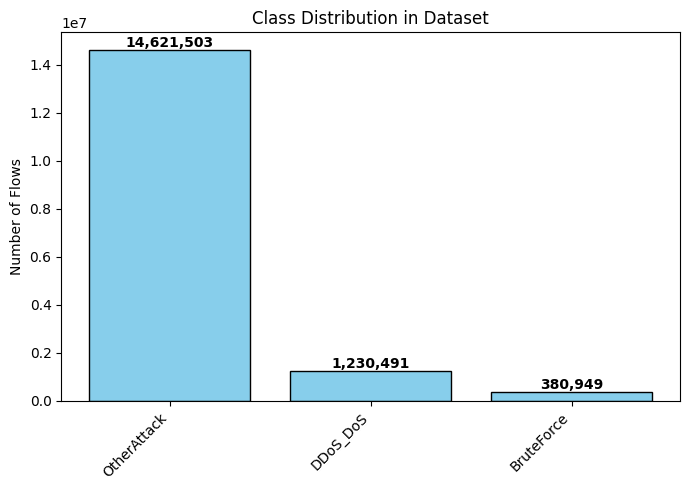

In [0]:
import matplotlib.pyplot as plt
import numpy as np

# Load class distribution from gold (or silver)
class_counts = (
    df_gold.groupBy("Label_Class").count().toPandas()
)

labels = class_counts["Label_Class"].values
counts = class_counts["count"].values

plt.figure(figsize=(7, 5))
bars = plt.bar(labels, counts, color="skyblue", edgecolor="black")

# Add numbers on top of the bars
for bar in bars:
    height = bar.get_height()
    plt.text(
        bar.get_x() + bar.get_width() / 2,
        height,
        f"{height:,}",     # adds comma formatting
        ha="center",
        va="bottom",
        fontsize=10,
        fontweight="bold"
    )

plt.xticks(rotation=45, ha="right")
plt.ylabel("Number of Flows")
plt.title("Class Distribution in Dataset")
plt.tight_layout()
plt.show()


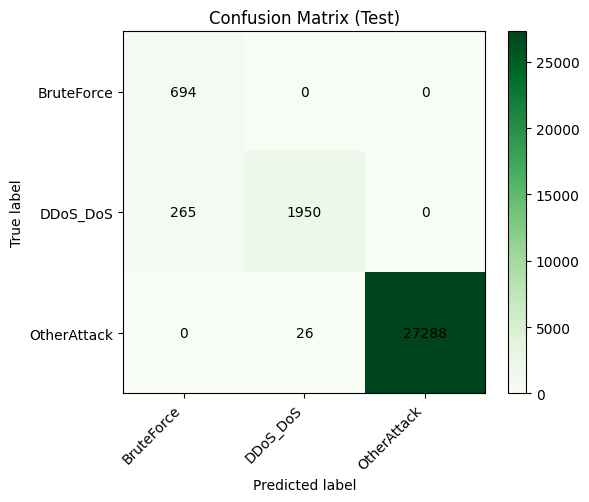

In [0]:
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import numpy as np

cm = confusion_matrix(y_test, y_test_pred)
classes = le.classes_  # same order as label indices

plt.figure(figsize=(6, 5))
plt.imshow(cm, interpolation="nearest", cmap="Greens")
plt.title("Confusion Matrix (Test)")
plt.colorbar()

tick_marks = np.arange(len(classes))
plt.xticks(tick_marks, classes, rotation=45, ha="right")
plt.yticks(tick_marks, classes)

# Print numbers on the cells
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        plt.text(j, i, cm[i, j],
                 ha="center", va="center")

plt.xlabel("Predicted label")
plt.ylabel("True label")
plt.tight_layout()
plt.show()


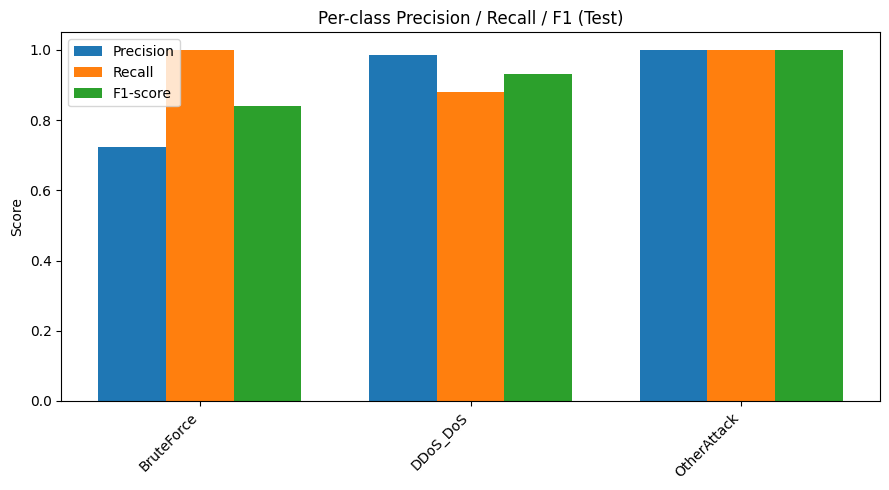

In [0]:
from sklearn.metrics import precision_recall_fscore_support
import matplotlib.pyplot as plt
import numpy as np

classes = le.classes_

prec, rec, f1, support = precision_recall_fscore_support(
    y_test, y_test_pred, labels=np.arange(len(classes))
)

x = np.arange(len(classes))
width = 0.25

plt.figure(figsize=(9, 5))
plt.bar(x - width, prec, width, label="Precision")
plt.bar(x,         rec,  width, label="Recall")
plt.bar(x + width, f1,   width, label="F1-score")

plt.xticks(x, classes, rotation=45, ha="right")
plt.ylim(0, 1.05)
plt.ylabel("Score")
plt.title("Per-class Precision / Recall / F1 (Test)")
plt.legend()
plt.tight_layout()
plt.show()


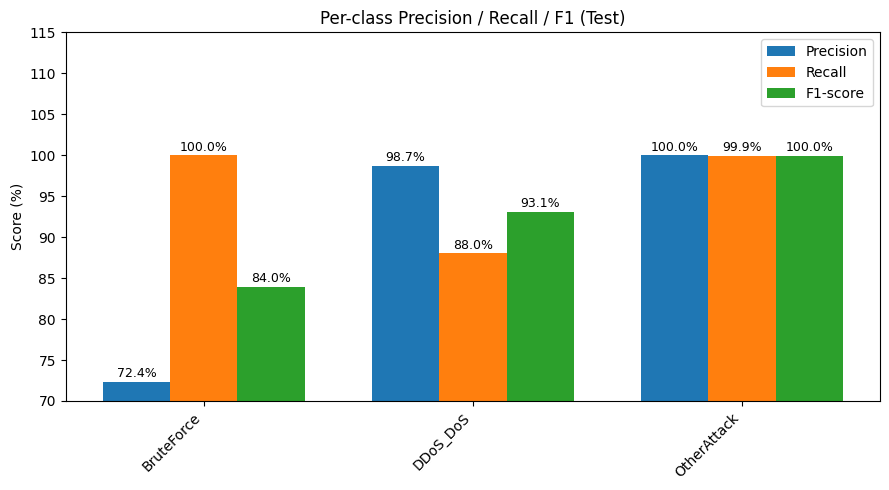

In [0]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import precision_recall_fscore_support

classes = le.classes_

# Get metrics
prec, rec, f1, support = precision_recall_fscore_support(
    y_test, y_test_pred, labels=np.arange(len(classes))
)

# Convert to percentages
prec_p = prec * 100
rec_p  = rec  * 100
f1_p   = f1   * 100

x = np.arange(len(classes))
width = 0.25

plt.figure(figsize=(9, 5))

bars1 = plt.bar(x - width, prec_p, width, label="Precision")
bars2 = plt.bar(x,         rec_p,  width, label="Recall")
bars3 = plt.bar(x + width, f1_p,   width, label="F1-score")

plt.xticks(x, classes, rotation=45, ha="right")
plt.ylim(70, 115)  # zoomed-in range so small differences show
plt.ylabel("Score (%)")
plt.title("Per-class Precision / Recall / F1 (Test)")
plt.legend()

# Add numbers on top of each bar
def add_labels(bars):
    for b in bars:
        height = b.get_height()
        plt.text(
            b.get_x() + b.get_width() / 2,
            height + 0.2,          # a bit above the bar
            f"{height:.1f}%",      # one decimal, percent
            ha="center",
            va="bottom",
            fontsize=9
        )

add_labels(bars1)
add_labels(bars2)
add_labels(bars3)

plt.tight_layout()
plt.show()


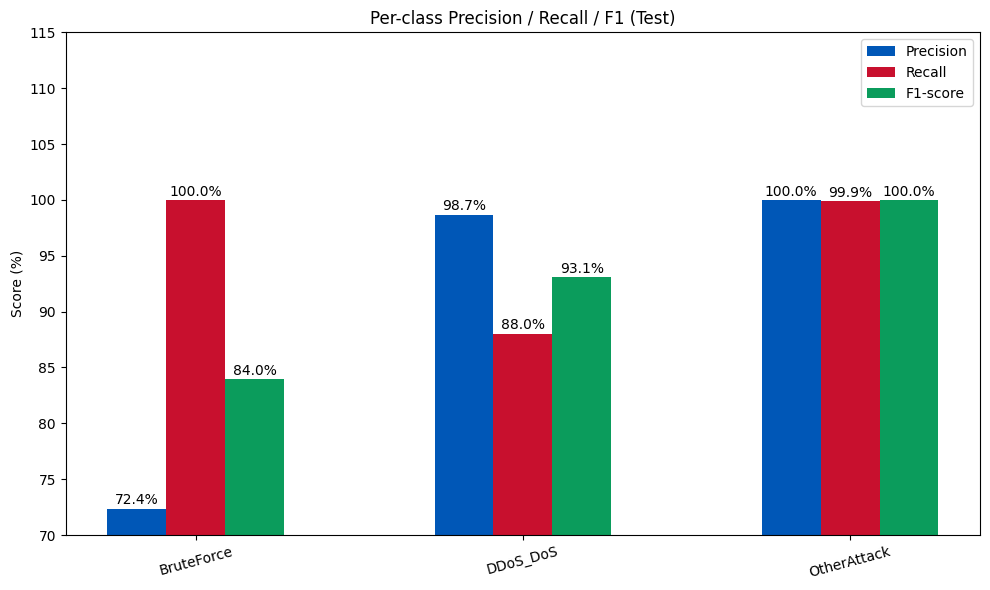

In [0]:
import matplotlib.pyplot as plt
import numpy as np

# your classes + metrics must already exist
# classes = [...]
# prec_p, rec_p, f1_p = [...]

x = np.arange(len(classes))
width = 0.18   # thinner bars

# Strong, masculine cyber-security colors
color_prec = "#0057B7"   # Deep Blue
color_rec  = "#C8102E"   # Tactical Red
color_f1   = "#0B9C5C"   # Combat Green

plt.figure(figsize=(10, 6))

bars1 = plt.bar(x - width, prec_p, width,
                label="Precision", color=color_prec)

bars2 = plt.bar(x, rec_p, width,
                label="Recall", color=color_rec)

bars3 = plt.bar(x + width, f1_p, width,
                label="F1-score", color=color_f1)

plt.xticks(x, classes, rotation=15, ha="center")
plt.ylim(70, 115)
plt.ylabel("Score (%)")
plt.title("Per-class Precision / Recall / F1 (Test)")
plt.legend()

# Add labels
def add_labels(bars, color="white"):
    for b in bars:
        value = b.get_height()
        plt.text(
            b.get_x() + b.get_width()/2,
            value + 0.1,
            f"{value:.1f}%",
            ha="center",
            va="bottom",
            fontsize=10,
            color="black"   # dark text for visibility
        )

add_labels(bars1)
add_labels(bars2)
add_labels(bars3)

plt.tight_layout()
plt.show()


### **# Saving The Pipeline**

In [0]:
import os
import pickle

local_model_path = "/tmp/cic_ids2018_rf.pkl"

with open(local_model_path, "wb") as f:
    pickle.dump(clf, f)

print("Saved locally at:", local_model_path)


Saved locally at: /tmp/cic_ids2018_rf.pkl


In [0]:
import pickle

preproc_path = "/tmp/cic_ids2018_preproc.pkl"

preproc_bundle = {
    "imputer": imputer,
    "scaler": scaler,
    "feature_cols": feature_cols,
    "class_names": classes,   # if you defined this earlier
}

with open(preproc_path, "wb") as f:
    pickle.dump(preproc_bundle, f)

print("Saved preprocessing bundle at:", preproc_path)


Saved preprocessing bundle at: /tmp/cic_ids2018_preproc.pkl


In [0]:
import pickle

model_path   = "/tmp/cic_ids2018_rf.pkl"
preproc_path = "/tmp/cic_ids2018_preproc.pkl"

with open(model_path, "rb") as f:
    clf_loaded = pickle.load(f)

with open(preproc_path, "rb") as f:
    preproc = pickle.load(f)

imputer_loaded     = preproc["imputer"]
scaler_loaded      = preproc["scaler"]
feature_cols_loaded = preproc["feature_cols"]
class_names_loaded  = preproc["class_names"]

print("Model & preprocessing reloaded.")
print("Features:", len(feature_cols_loaded), "Classes:", class_names_loaded)


Model & preprocessing reloaded.
Features: 78 Classes: ['BruteForce' 'DDoS_DoS' 'OtherAttack']


In [0]:
import numpy as np

def predict_from_spark(df_spark):
    """
    df_spark: Spark DataFrame with at least the feature columns used in training
    returns: numpy array of predictions (numeric labels) and class names
    """
    # select features in correct order and convert to pandas
    pdf = df_spark.select(feature_cols_loaded).toPandas()

    # convert to numpy
    X = pdf.values

    # same preprocessing as training
    X_clean    = np.where(np.isfinite(X), X, np.nan)
    X_imputed  = imputer_loaded.transform(X_clean)
    X_scaled   = scaler_loaded.transform(X_imputed)

    # predict
    y_pred = clf_loaded.predict(X_scaled)
    labels = [class_names_loaded[int(i)] for i in y_pred]

    return y_pred, labels


In [0]:
gold_path = "abfss://raw@projectab2ib.dfs.core.windows.net/Curated"

df_gold_for_infer = spark.read.parquet(gold_path).limit(10)  # just a sample

y_pred_idx, y_pred_labels = predict_from_spark(df_gold_for_infer)

print("Numeric predictions:", y_pred_idx)
print("Label predictions:", y_pred_labels)


/databricks/python/lib/python3.12/site-packages/sklearn/impute/_base.py:577: UserWarning: Skipping features without any observed values: [72]. At least one non-missing value is needed for imputation with strategy='median'.
  warnings.warn(


Numeric predictions: [2 2 2 2 2 2 2 2 2 2]
Label predictions: ['OtherAttack', 'OtherAttack', 'OtherAttack', 'OtherAttack', 'OtherAttack', 'OtherAttack', 'OtherAttack', 'OtherAttack', 'OtherAttack', 'OtherAttack']


# **Deployment**

In [0]:
import mlflow
import mlflow.pyfunc
from mlflow.models.signature import infer_signature
import pandas as pd
import numpy as np

# 1) Define a wrapper that applies preprocessing + model
class CICIDSModel(mlflow.pyfunc.PythonModel):
    def __init__(self, clf, imputer, scaler, feature_cols, class_names):
        self.clf = clf
        self.imputer = imputer
        self.scaler = scaler
        self.feature_cols = feature_cols
        self.class_names = class_names

    def predict(self, context, model_input):
        """
        model_input: pandas DataFrame with at least the feature columns
        returns: predicted class names
        """
        # Ensure columns in correct order
        X = model_input[self.feature_cols].values

        # Same preprocessing as training
        X_clean   = np.where(np.isfinite(X), X, np.nan)
        X_imputed = self.imputer.transform(X_clean)
        X_scaled  = self.scaler.transform(X_imputed)

        # Predict numeric labels, then map to names
        y_pred      = self.clf.predict(X_scaled)
        label_names = [self.class_names[int(i)] for i in y_pred]
        return pd.Series(label_names, name="prediction")

# 2) Create the pyfunc model instance
pyfunc_model = CICIDSModel(
    clf=clf,
    imputer=imputer,
    scaler=scaler,
    feature_cols=feature_cols,
    class_names=classes,
)


In [0]:
gold_path = "abfss://raw@projectab2ib.dfs.core.windows.net/Curated"
df_gold_sample = spark.read.parquet(gold_path).select(feature_cols).limit(10)
input_example = df_gold_sample.toPandas()

# Signature: how inputs/outputs look
signature = infer_signature(input_example, pyfunc_model.predict(None, input_example))


/databricks/python/lib/python3.12/site-packages/sklearn/impute/_base.py:577: UserWarning: Skipping features without any observed values: [72]. At least one non-missing value is needed for imputation with strategy='median'.
  warnings.warn(
/databricks/python/lib/python3.12/site-packages/mlflow/types/utils.py:435: UserWarning: Hint: Inferred schema contains integer column(s). Integer columns in Python cannot represent missing values. If your input data contains missing values at inference time, it will be encoded as floats and will cause a schema enforcement error. The best way to avoid this problem is to infer the model schema based on a realistic data sample (training dataset) that includes missing values. Alternatively, you can declare integer columns as doubles (float64) whenever these columns may have missing values. See `Handling Integers With Missing Values <https://www.mlflow.org/docs/latest/models.html#handling-integers-with-missing-values>`_ for more details.
  warnings.warn(


In [0]:
import mlflow

# Put all runs for this project in one experiment
mlflow.set_experiment("/Shared/cic_ids2018_experiment")

with mlflow.start_run(run_name="rf_cic_ids2018_serving") as run:
    mlflow.pyfunc.log_model(
        artifact_path="model",
        python_model=pyfunc_model,
        signature=signature,
        input_example=input_example,
    )

    run_id = run.info.run_id
    model_uri = f"runs:/{run_id}/model"

print("MLflow run_id:", run_id)
print("Model URI   :", model_uri)


2025/12/02 07:42:29 INFO mlflow.tracking.fluent: Experiment with name '/Shared/cic_ids2018_experiment' does not exist. Creating a new experiment.
2025/12/02 07:42:40 WARNING mlflow.models.model: Failed to validate serving input example {
  "dataframe_split": {
    "columns": [
      "ACK_Flag_Cnt",
      "Active_Max",
      "Active_Mean",
      "Active_Min",
      "Active_Std",
      "Bwd_Blk_Rate_Avg",
      "Bwd_Byts_b_Avg",
      "Bwd_Header_Len",
      "Bwd_IAT_Max",
      "Bwd_IAT_Mean",
      "Bwd_IAT_Min",
      "Bwd_IAT_Std",
      "Bwd_IAT_Tot",
      "Bwd_PSH_Flags",
      "Bwd_Pkt_Len_Max",
      "Bwd_Pkt_Len_Mean",
      "Bwd_Pkt_Len_Min",
      "Bwd_Pkt_Len_Std",
      "Bwd_Pkts_b_Avg",
      "Bwd_Pkts_s",
      "Bwd_Seg_Size_Avg",
      "Bwd_URG_Flags",
      "CWE_Flag_Count",
      "Down_Up_Ratio",
      "Dst_Port",
      "ECE_Flag_Cnt",
      "FIN_Flag_Cnt",
      "Flow_Byts_s",
      "Flow_IAT_Max",
      "Flow_IAT_Mean",
      "Flow_IAT_Min",
      "Flow_IAT_Std",
   

🏃 View run rf_cic_ids2018_serving at: https://adb-1029032443822198.18.azuredatabricks.net/ml/experiments/3347471290863979/runs/d38ae3a4fd284194a151d70569bbb52f
🧪 View experiment at: https://adb-1029032443822198.18.azuredatabricks.net/ml/experiments/3347471290863979
MLflow run_id: d38ae3a4fd284194a151d70569bbb52f
Model URI   : runs:/d38ae3a4fd284194a151d70569bbb52f/model
